In [1]:
import sys
import os
from glob import glob
sys.path.append("../NEAT")
from NEATModels import NEATDynamic, nets
from NEATModels.config import dynamic_config
from NEATUtils import helpers
from NEATUtils.helpers import save_json, load_json
os.environ["CUDA_VISIBLE_DEVICES"]="0"
os.environ["HDF5_USE_FILE_LOCKING"] = "FALSE"


Using TensorFlow backend.


In [2]:
npz_directory = '/home/sancere/Kepler/CurieTrainingDatasets/oneatnpz/'
npz_name = 'apoptosismodelbin1.npz'
npz_val_name = 'apoptosismodelbin1val.npz'

#Read and Write the h5 file, directory location and name
model_dir =  '/home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/'
model_name = 'wtapoptosisd29s4f16.h5'

In [3]:
#Neural network parameters
division_categories_json = model_dir + 'ApoptosisCategories.json'
key_categories = load_json(division_categories_json)
division_cord_json = model_dir + 'ApoptosisCord.json'
key_cord = load_json(division_cord_json)

#For ORNET use residual = True and for OSNET use residual = False
residual = True
#NUmber of starting convolutional filters, is doubled down with increasing depth
startfilter = 16
#CNN network start layer, mid layers and lstm layer kernel size
start_kernel = 7
lstm_kernel = 3
mid_kernel = 3
#Network depth has to be 9n + 2, n= 3 or 4 is optimal for Notum dataset
depth = 29
#Size of the gradient descent length vector, start small and use callbacks to get smaller when reaching the minima
learning_rate = 1.0E-3
#For stochastic gradient decent, the batch size used for computing the gradients
batch_size = 4
# use softmax for single event per box, sigmoid for multi event per box
lstm_hidden_unit = 16
#Training epochs, longer the better with proper chosen learning rate
epochs = 250
nboxes = 1
#The inbuilt model stride which is equal to the nulber of times image was downsampled by the network
show = True
stage_number = 4
last_conv_factor = 8
size_tminus = 5
size_tplus = 5
imagex = 96
imagey = 96
yolo_v0 = False
yolo_v1 = True
yolo_v2 = False

In [6]:

config = dynamic_config(npz_directory =npz_directory, npz_name = npz_name, npz_val_name = npz_val_name, 
                         key_categories = key_categories, key_cord = key_cord, nboxes = nboxes, imagex = imagex,
                         imagey = imagey, size_tminus = size_tminus, size_tplus =size_tplus, epochs = epochs, yolo_v0 = yolo_v0, yolo_v1 = yolo_v1, yolo_v2 = yolo_v2,
                         residual = residual, depth = depth, start_kernel = start_kernel, mid_kernel = mid_kernel, stage_number = stage_number, last_conv_factor = last_conv_factor,
                         lstm_kernel = lstm_kernel, lstm_hidden_unit = lstm_hidden_unit, show = show,
                         startfilter = startfilter, batch_size = batch_size, model_name = model_name)

config_json = config.to_json()

print(config)
save_json(config_json, model_dir + os.path.splitext(model_name)[0] + '_Parameter.json')

dynamic_config(batch_size=4, box_vector=6, categories=2, depth=29, epochs=250, imagex=96, imagey=96, key_categories={'Normal': 0, 'Apoptosis': 1}, key_cord={'x': 0, 'y': 1, 't': 2, 'h': 3, 'w': 4, 'c': 5}, last_conv_factor=8, learning_rate=0.0001, lstm_hidden_unit=16, lstm_kernel=3, mid_kernel=3, model_name='wtapoptosisd29s4f16.h5', multievent=False, nboxes=1, npz_directory='/home/sancere/Kepler/CurieTrainingDatasets/oneatnpz/', npz_name='apoptosismodelbin1.npz', npz_val_name='apoptosismodelbin1val.npz', residual=True, show=True, size_tminus=5, size_tplus=5, stage_number=4, start_kernel=7, startfilter=16, stride=8, yolo_v0=False, yolo_v1=True, yolo_v2=False)


number of  images:	 8455
image size (3D):		 (11, 96, 96)
axes:				 STXYC
channels in / out:		 1
number of  images:	 446
image size (3D):		 (11, 96, 96)
axes:				 STXYC
channels in / out:		 1
(8455, 1, 1, 8) 1
notbinary
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            (None, 11, None, Non 0                                            
__________________________________________________________________________________________________
time_distributed_114 (TimeDistr (None, 11, None, Non 800         input_2[0][0]                    
__________________________________________________________________________________________________
conv3d_42 (Conv3D)              (None, 11, None, Non 5504        input_2[0][0]                    
_______________________________________________________________________

Train on 8455 samples, validate on 446 samples
Epoch 1/250


2021-09-01 00:43:35.673920: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudnn.so.7
2021-09-01 00:43:38.111339: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcublas.so.10


8455/8455 [==============================] - 976s 115ms/step - loss: 3.1200 - accuracy: 0.5844 - val_loss: 2.7990 - val_accuracy: 0.8812

Epoch 00001: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


<Figure size 432x288 with 0 Axes>

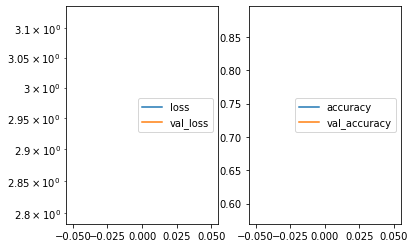

Predicted cell: Normal Probability: [[0.9985488]]
True Cell type: Normal
x [[0.5293717]]
True positional value x 0.5
y [[0.5084374]]
True positional value y 0.5
t [[0.48009178]]
True positional value t 0.5
h [[0.570806]]
True positional value h 0.3645833333333333
w [[0.62724155]]
True positional value w 0.5625
c [[0.89542603]]
True positional value c 1.0


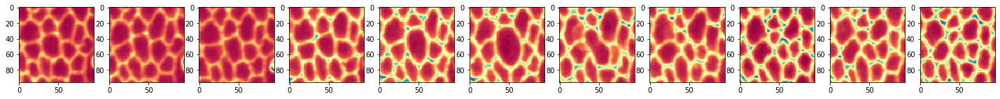

Epoch 2/250
8455/8455 [==============================] - 945s 112ms/step - loss: 2.7652 - accuracy: 0.8854 - val_loss: 2.7411 - val_accuracy: 0.9283

Epoch 00002: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


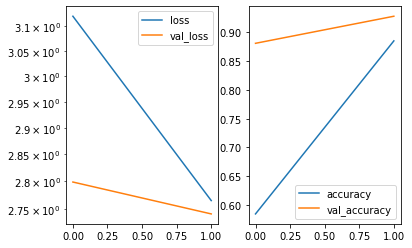

Predicted cell: Apoptosis Probability: [[0.9929785]]
True Cell type: Apoptosis
x [[0.45740932]]
True positional value x 0.5
y [[0.49084696]]
True positional value y 0.5
t [[0.49485466]]
True positional value t 0.5
h [[0.07258392]]
True positional value h 0.041666666666666664
w [[0.10034654]]
True positional value w 0.08333333333333333
c [[0.9027277]]
True positional value c 1.0


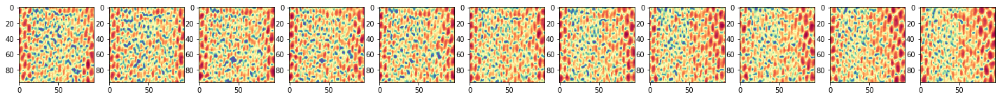

Epoch 3/250
8455/8455 [==============================] - 951s 113ms/step - loss: 2.7111 - accuracy: 0.9196 - val_loss: 2.7422 - val_accuracy: 0.9103

Epoch 00003: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


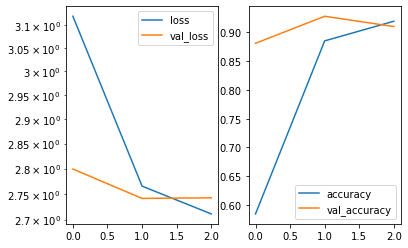

Predicted cell: Apoptosis Probability: [[0.9980642]]
True Cell type: Apoptosis
x [[0.50130945]]
True positional value x 0.5
y [[0.48519084]]
True positional value y 0.5
t [[0.47908163]]
True positional value t 0.5
h [[0.08666904]]
True positional value h 0.052083333333333336
w [[0.10295641]]
True positional value w 0.08333333333333333
c [[0.88446534]]
True positional value c 1.0


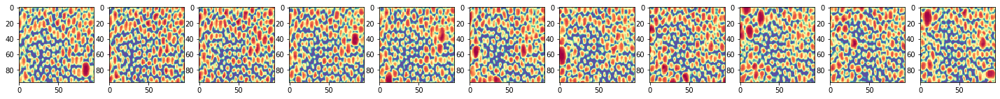

Epoch 4/250
8455/8455 [==============================] - 949s 112ms/step - loss: 2.6747 - accuracy: 0.9353 - val_loss: 2.6991 - val_accuracy: 0.9260

Epoch 00004: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


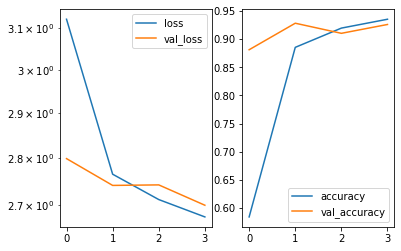

Predicted cell: Apoptosis Probability: [[0.9981312]]
True Cell type: Apoptosis
x [[0.4992197]]
True positional value x 0.5
y [[0.48629758]]
True positional value y 0.5
t [[0.5164739]]
True positional value t 0.5
h [[0.05528832]]
True positional value h 0.09375
w [[0.06880195]]
True positional value w 0.09375
c [[0.9529276]]
True positional value c 1.0


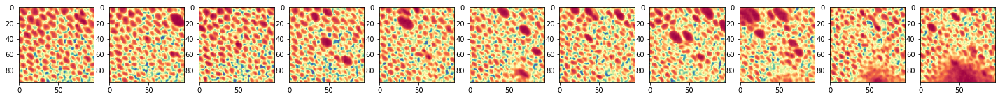

Epoch 5/250
8455/8455 [==============================] - 946s 112ms/step - loss: 2.6411 - accuracy: 0.9491 - val_loss: 2.6716 - val_accuracy: 0.9596

Epoch 00005: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


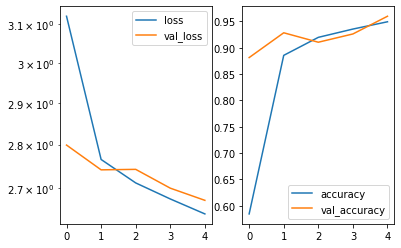

Predicted cell: Apoptosis Probability: [[0.9999994]]
True Cell type: Apoptosis
x [[0.5093034]]
True positional value x 0.5
y [[0.533181]]
True positional value y 0.5
t [[0.5155451]]
True positional value t 0.5
h [[0.0430712]]
True positional value h 0.052083333333333336
w [[0.06998187]]
True positional value w 0.052083333333333336
c [[0.90919024]]
True positional value c 1.0


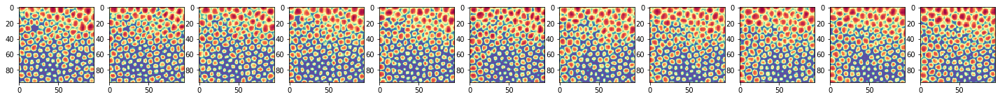

Epoch 6/250
8455/8455 [==============================] - 947s 112ms/step - loss: 2.6135 - accuracy: 0.9565 - val_loss: 2.6321 - val_accuracy: 0.9552

Epoch 00006: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


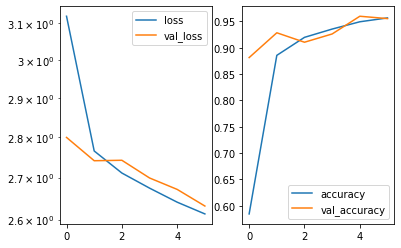

Predicted cell: Apoptosis Probability: [[0.91734797]]
True Cell type: Apoptosis
x [[0.46726602]]
True positional value x 0.5
y [[0.48360828]]
True positional value y 0.5
t [[0.5093911]]
True positional value t 0.5
h [[0.07978702]]
True positional value h 0.041666666666666664
w [[0.10586867]]
True positional value w 0.052083333333333336
c [[0.9323514]]
True positional value c 1.0


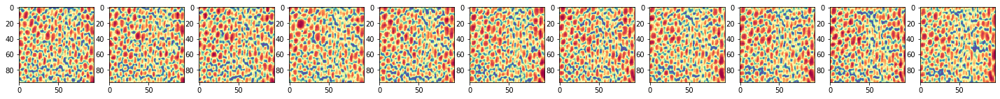

Epoch 7/250
8455/8455 [==============================] - 948s 112ms/step - loss: 2.5814 - accuracy: 0.9695 - val_loss: 2.6143 - val_accuracy: 0.9552

Epoch 00007: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


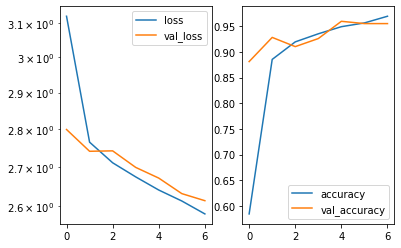

Predicted cell: Apoptosis Probability: [[0.98374176]]
True Cell type: Apoptosis
x [[0.5033908]]
True positional value x 0.5
y [[0.49461487]]
True positional value y 0.5
t [[0.525092]]
True positional value t 0.5
h [[0.07112548]]
True positional value h 0.041666666666666664
w [[0.08904783]]
True positional value w 0.041666666666666664
c [[0.940536]]
True positional value c 1.0


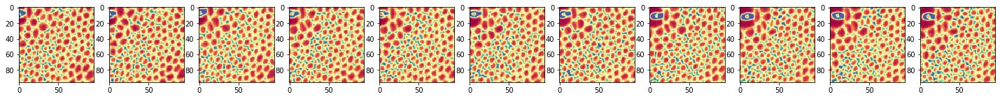

Epoch 8/250
8455/8455 [==============================] - 943s 112ms/step - loss: 2.5593 - accuracy: 0.9742 - val_loss: 2.6036 - val_accuracy: 0.9462

Epoch 00008: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


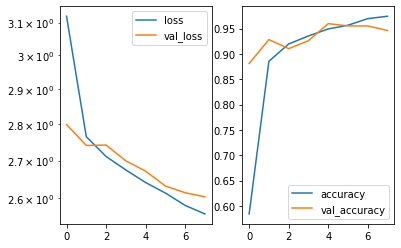

Predicted cell: Apoptosis Probability: [[0.99467516]]
True Cell type: Apoptosis
x [[0.4934337]]
True positional value x 0.5
y [[0.4980558]]
True positional value y 0.5
t [[0.49623924]]
True positional value t 0.5
h [[0.058167]]
True positional value h 0.07291666666666667
w [[0.07757559]]
True positional value w 0.09375
c [[0.9386879]]
True positional value c 1.0


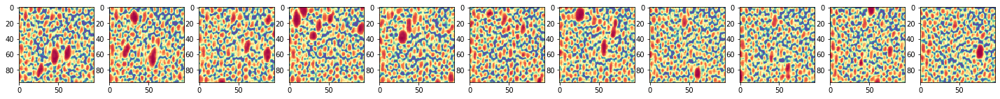

Epoch 9/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.5329 - accuracy: 0.9801 - val_loss: 2.6555 - val_accuracy: 0.9170

Epoch 00009: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


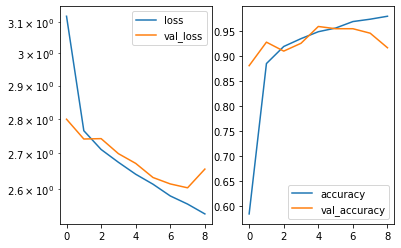

Predicted cell: Normal Probability: [[0.9997429]]
True Cell type: Normal
x [[0.510436]]
True positional value x 0.5
y [[0.4863057]]
True positional value y 0.5
t [[0.48821035]]
True positional value t 0.5
h [[0.5054045]]
True positional value h 0.59375
w [[0.5355181]]
True positional value w 0.65625
c [[0.9610081]]
True positional value c 1.0


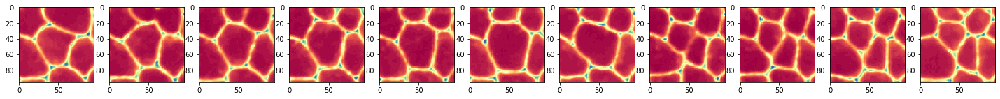

Epoch 10/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.5105 - accuracy: 0.9824 - val_loss: 2.5688 - val_accuracy: 0.9596

Epoch 00010: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


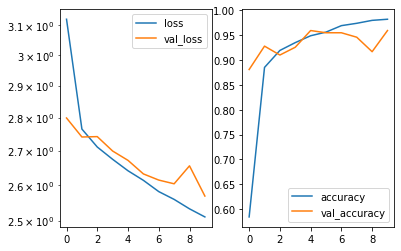

Predicted cell: Apoptosis Probability: [[0.9999962]]
True Cell type: Apoptosis
x [[0.47808632]]
True positional value x 0.5
y [[0.49479395]]
True positional value y 0.5
t [[0.50030226]]
True positional value t 0.5
h [[0.033554]]
True positional value h 0.052083333333333336
w [[0.03322593]]
True positional value w 0.0625
c [[0.96477014]]
True positional value c 1.0


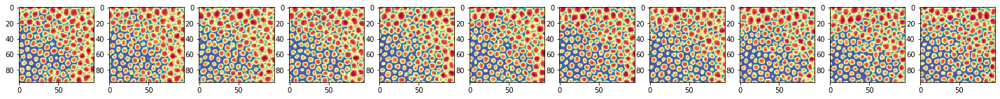

Epoch 11/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.4849 - accuracy: 0.9888 - val_loss: 2.5705 - val_accuracy: 0.9350

Epoch 00011: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


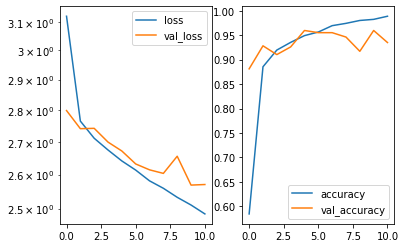

Predicted cell: Apoptosis Probability: [[0.980838]]
True Cell type: Apoptosis
x [[0.52666616]]
True positional value x 0.5
y [[0.4909173]]
True positional value y 0.5
t [[0.4830657]]
True positional value t 0.5
h [[0.14015831]]
True positional value h 0.052083333333333336
w [[0.13333759]]
True positional value w 0.08333333333333333
c [[0.9198102]]
True positional value c 1.0


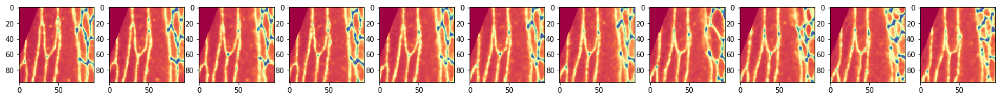

Epoch 12/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.4694 - accuracy: 0.9862 - val_loss: 2.5245 - val_accuracy: 0.9596

Epoch 00012: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


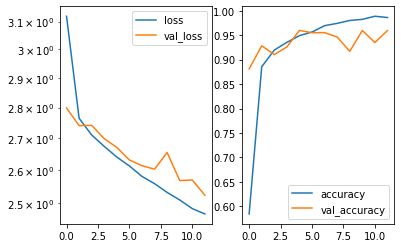

Predicted cell: Normal Probability: [[0.9999976]]
True Cell type: Normal
x [[0.49995142]]
True positional value x 0.5
y [[0.48965696]]
True positional value y 0.5
t [[0.5127631]]
True positional value t 0.5
h [[0.60246956]]
True positional value h 0.5729166666666666
w [[0.6212277]]
True positional value w 0.6041666666666666
c [[0.9564235]]
True positional value c 1.0


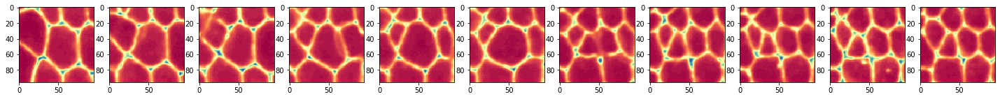

Epoch 13/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.4447 - accuracy: 0.9890 - val_loss: 2.5010 - val_accuracy: 0.9776

Epoch 00013: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


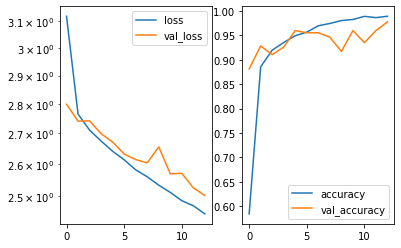

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.50580204]]
True positional value x 0.5
y [[0.5062968]]
True positional value y 0.5
t [[0.51091415]]
True positional value t 0.5
h [[0.5324383]]
True positional value h 0.5104166666666666
w [[0.69749874]]
True positional value w 0.59375
c [[0.968965]]
True positional value c 1.0


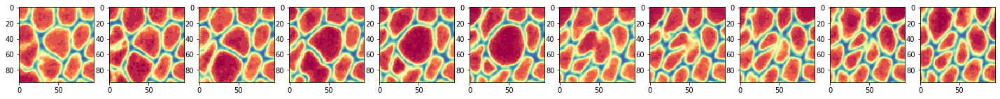

Epoch 14/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.4249 - accuracy: 0.9904 - val_loss: 2.4730 - val_accuracy: 0.9709

Epoch 00014: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


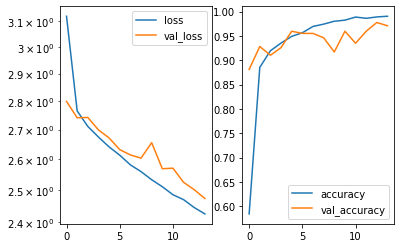

Predicted cell: Normal Probability: [[0.99999785]]
True Cell type: Normal
x [[0.4869637]]
True positional value x 0.5
y [[0.4971655]]
True positional value y 0.5
t [[0.4957017]]
True positional value t 0.5
h [[0.34999985]]
True positional value h 0.3020833333333333
w [[0.34177586]]
True positional value w 0.3125
c [[0.95425177]]
True positional value c 1.0


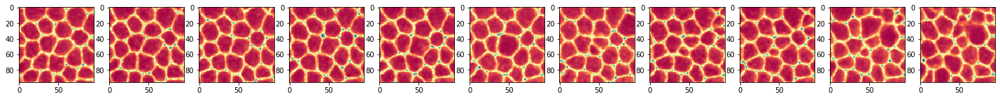

Epoch 15/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.4044 - accuracy: 0.9923 - val_loss: 2.4805 - val_accuracy: 0.9641

Epoch 00015: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


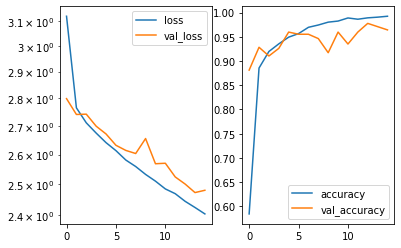

Predicted cell: Apoptosis Probability: [[0.9999887]]
True Cell type: Apoptosis
x [[0.51212656]]
True positional value x 0.5
y [[0.52121973]]
True positional value y 0.5
t [[0.50686646]]
True positional value t 0.5
h [[0.06960282]]
True positional value h 0.052083333333333336
w [[0.0956367]]
True positional value w 0.0625
c [[0.9198396]]
True positional value c 1.0


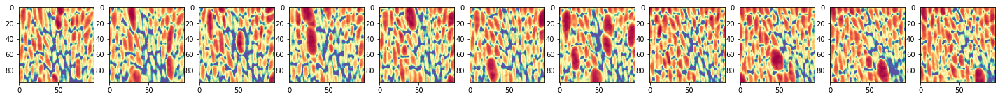

Epoch 16/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.3878 - accuracy: 0.9876 - val_loss: 2.4408 - val_accuracy: 0.9753

Epoch 00016: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


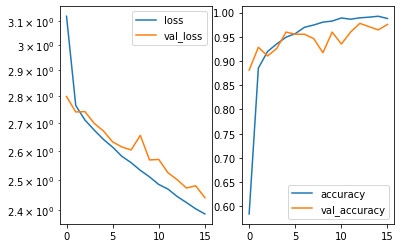

Predicted cell: Apoptosis Probability: [[0.99998355]]
True Cell type: Apoptosis
x [[0.50120914]]
True positional value x 0.5
y [[0.51024514]]
True positional value y 0.5
t [[0.49025202]]
True positional value t 0.5
h [[0.07893267]]
True positional value h 0.041666666666666664
w [[0.09142252]]
True positional value w 0.09375
c [[0.887177]]
True positional value c 1.0


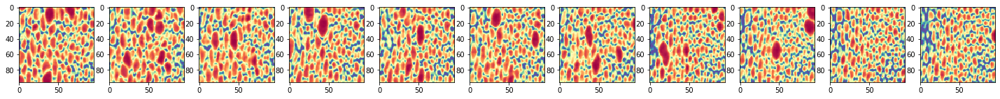

Epoch 17/250
8455/8455 [==============================] - 939s 111ms/step - loss: 2.3658 - accuracy: 0.9938 - val_loss: 2.4308 - val_accuracy: 0.9664

Epoch 00017: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


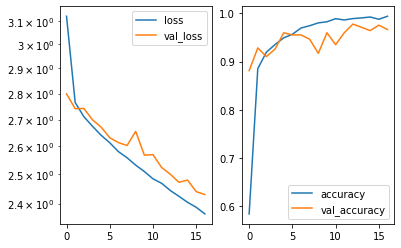

Predicted cell: Normal Probability: [[0.99996924]]
True Cell type: Normal
x [[0.5024216]]
True positional value x 0.5
y [[0.49596676]]
True positional value y 0.5
t [[0.49442044]]
True positional value t 0.5
h [[0.5671253]]
True positional value h 0.46875
w [[0.5829416]]
True positional value w 0.4895833333333333
c [[0.94325656]]
True positional value c 1.0


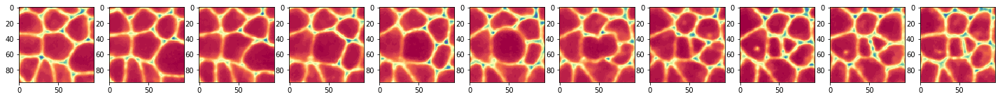

Epoch 18/250
8455/8455 [==============================] - 939s 111ms/step - loss: 2.3444 - accuracy: 0.9957 - val_loss: 2.4047 - val_accuracy: 0.9731

Epoch 00018: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


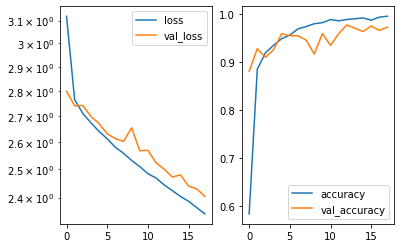

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.4861144]]
True positional value x 0.5
y [[0.5091391]]
True positional value y 0.5
t [[0.507521]]
True positional value t 0.5
h [[0.5150337]]
True positional value h 0.5416666666666666
w [[0.5547418]]
True positional value w 0.59375
c [[0.972683]]
True positional value c 1.0


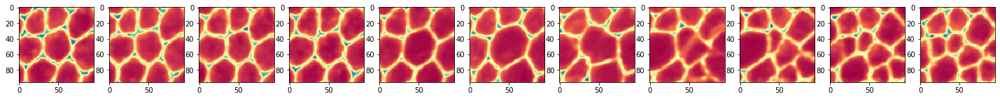

Epoch 19/250
8455/8455 [==============================] - 939s 111ms/step - loss: 2.3297 - accuracy: 0.9922 - val_loss: 2.4068 - val_accuracy: 0.9619

Epoch 00019: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


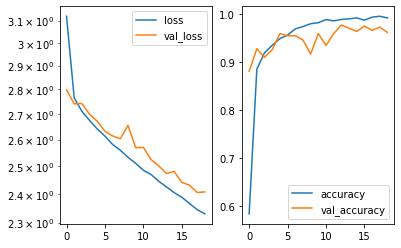

Predicted cell: Apoptosis Probability: [[0.9999981]]
True Cell type: Apoptosis
x [[0.48967382]]
True positional value x 0.5
y [[0.49961454]]
True positional value y 0.5
t [[0.5071498]]
True positional value t 0.5
h [[0.04644184]]
True positional value h 0.041666666666666664
w [[0.06373318]]
True positional value w 0.08333333333333333
c [[0.9326004]]
True positional value c 1.0


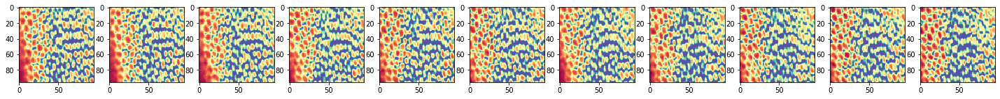

Epoch 20/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.3068 - accuracy: 0.9954 - val_loss: 2.3867 - val_accuracy: 0.9731

Epoch 00020: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


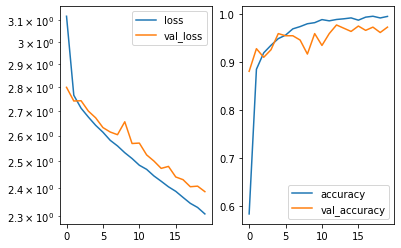

Predicted cell: Normal Probability: [[0.99999595]]
True Cell type: Normal
x [[0.5021737]]
True positional value x 0.5
y [[0.5099359]]
True positional value y 0.5
t [[0.5105224]]
True positional value t 0.5
h [[0.6236523]]
True positional value h 0.6354166666666666
w [[0.5796825]]
True positional value w 0.5520833333333334
c [[0.9677348]]
True positional value c 1.0


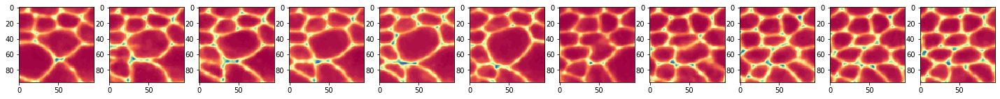

Epoch 21/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.2883 - accuracy: 0.9980 - val_loss: 2.3599 - val_accuracy: 0.9709

Epoch 00021: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


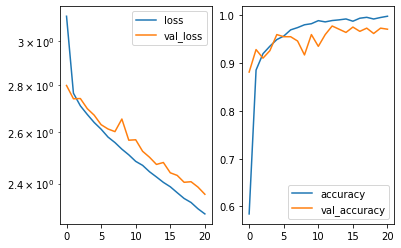

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.5004428]]
True positional value x 0.5
y [[0.50187665]]
True positional value y 0.5
t [[0.4973682]]
True positional value t 0.5
h [[0.49906138]]
True positional value h 0.4583333333333333
w [[0.5806885]]
True positional value w 0.5625
c [[0.95799285]]
True positional value c 1.0


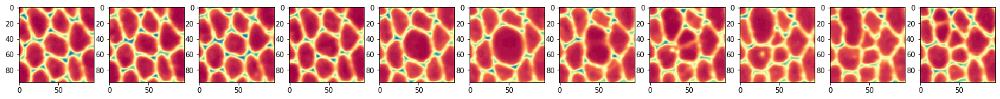

Epoch 22/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.2689 - accuracy: 0.9981 - val_loss: 2.3285 - val_accuracy: 0.9776

Epoch 00022: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


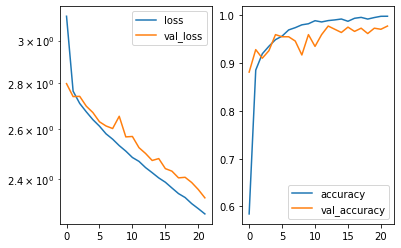

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.4905306]]
True positional value x 0.5
y [[0.4932182]]
True positional value y 0.5
t [[0.4940725]]
True positional value t 0.5
h [[0.36371422]]
True positional value h 0.2604166666666667
w [[0.4852075]]
True positional value w 0.46875
c [[0.95945984]]
True positional value c 1.0


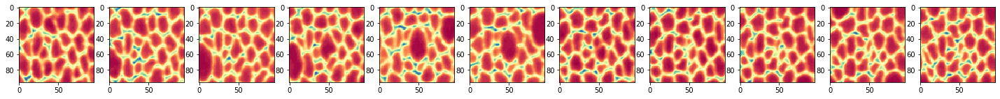

Epoch 23/250
8455/8455 [==============================] - 940s 111ms/step - loss: 2.2526 - accuracy: 0.9961 - val_loss: 2.3256 - val_accuracy: 0.9776

Epoch 00023: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


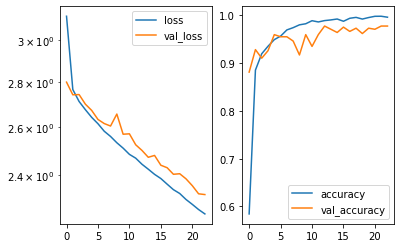

Predicted cell: Apoptosis Probability: [[0.9999783]]
True Cell type: Apoptosis
x [[0.5039327]]
True positional value x 0.5
y [[0.49299514]]
True positional value y 0.5
t [[0.4981704]]
True positional value t 0.5
h [[0.0560001]]
True positional value h 0.041666666666666664
w [[0.07532252]]
True positional value w 0.11458333333333333
c [[0.9264138]]
True positional value c 1.0


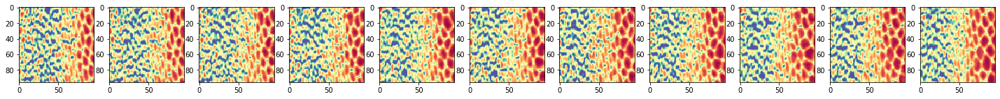

Epoch 24/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.2342 - accuracy: 0.9978 - val_loss: 2.3046 - val_accuracy: 0.9753

Epoch 00024: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


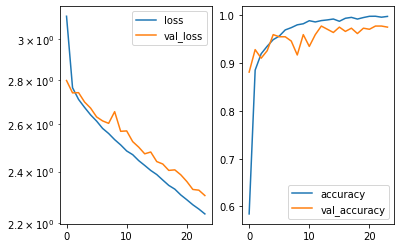

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.5129249]]
True positional value x 0.5
y [[0.49253616]]
True positional value y 0.5
t [[0.50004816]]
True positional value t 0.5
h [[0.43435717]]
True positional value h 0.5
w [[0.49747372]]
True positional value w 0.5208333333333334
c [[0.9367491]]
True positional value c 1.0


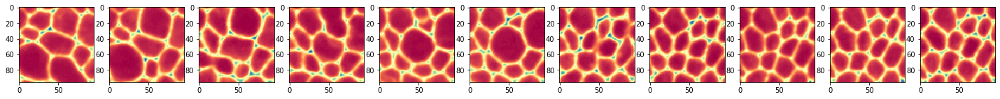

Epoch 25/250
8455/8455 [==============================] - 940s 111ms/step - loss: 2.2160 - accuracy: 0.9981 - val_loss: 2.2962 - val_accuracy: 0.9798

Epoch 00025: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


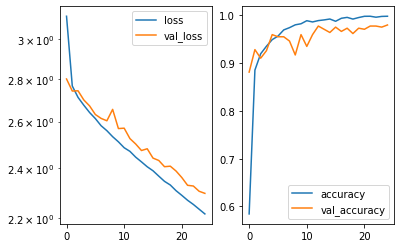

Predicted cell: Apoptosis Probability: [[0.9999378]]
True Cell type: Apoptosis
x [[0.53298134]]
True positional value x 0.5
y [[0.5042628]]
True positional value y 0.5
t [[0.48907846]]
True positional value t 0.5
h [[0.07140438]]
True positional value h 0.0625
w [[0.07719932]]
True positional value w 0.125
c [[0.9114723]]
True positional value c 1.0


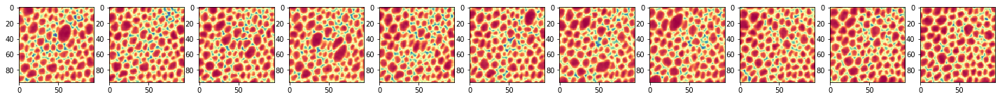

Epoch 26/250
8455/8455 [==============================] - 941s 111ms/step - loss: 2.1980 - accuracy: 0.9988 - val_loss: 2.2763 - val_accuracy: 0.9776

Epoch 00026: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


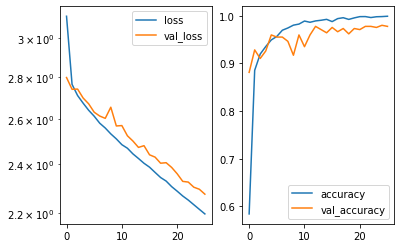

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.5083538]]
True positional value x 0.5
y [[0.51191133]]
True positional value y 0.5
t [[0.5023311]]
True positional value t 0.5
h [[0.6812069]]
True positional value h 0.5833333333333334
w [[0.6235817]]
True positional value w 0.53125
c [[0.95968485]]
True positional value c 1.0


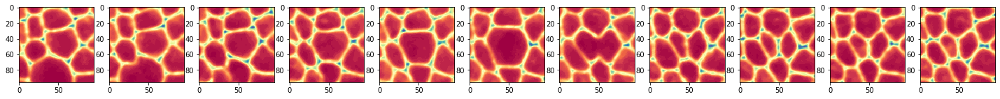

Epoch 27/250
8455/8455 [==============================] - 940s 111ms/step - loss: 2.1817 - accuracy: 0.9986 - val_loss: 2.2491 - val_accuracy: 0.9753

Epoch 00027: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


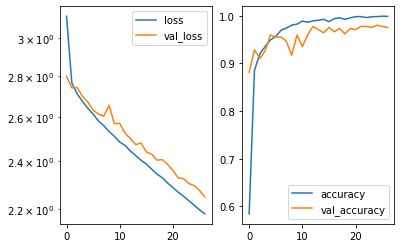

Predicted cell: Apoptosis Probability: [[0.9999869]]
True Cell type: Apoptosis
x [[0.5332281]]
True positional value x 0.5
y [[0.49397567]]
True positional value y 0.5
t [[0.5033628]]
True positional value t 0.5
h [[0.07405898]]
True positional value h 0.0625
w [[0.07160383]]
True positional value w 0.0625
c [[0.9566555]]
True positional value c 1.0


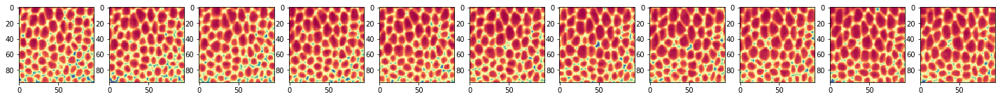

Epoch 28/250
8455/8455 [==============================] - 941s 111ms/step - loss: 2.1637 - accuracy: 0.9989 - val_loss: 2.2375 - val_accuracy: 0.9753

Epoch 00028: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


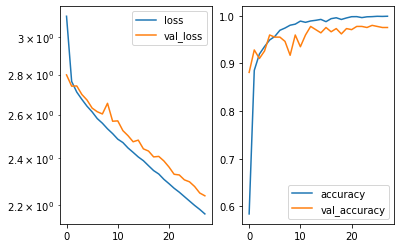

Predicted cell: Normal Probability: [[0.9999888]]
True Cell type: Normal
x [[0.49934438]]
True positional value x 0.5
y [[0.4981277]]
True positional value y 0.5
t [[0.5055558]]
True positional value t 0.5
h [[0.36345732]]
True positional value h 0.4895833333333333
w [[0.4010179]]
True positional value w 0.5729166666666666
c [[0.965421]]
True positional value c 1.0


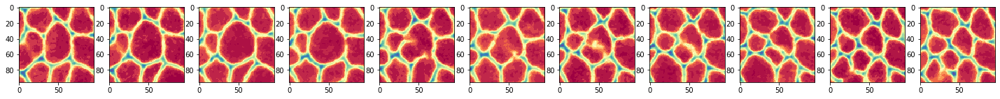

Epoch 29/250
8455/8455 [==============================] - 942s 111ms/step - loss: 2.1453 - accuracy: 0.9993 - val_loss: 2.2167 - val_accuracy: 0.9753

Epoch 00029: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


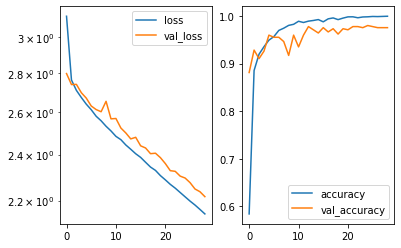

Predicted cell: Normal Probability: [[0.99999416]]
True Cell type: Normal
x [[0.51296735]]
True positional value x 0.5
y [[0.5094313]]
True positional value y 0.5
t [[0.49609122]]
True positional value t 0.5
h [[0.44239953]]
True positional value h 0.5625
w [[0.5967528]]
True positional value w 0.65625
c [[0.94566774]]
True positional value c 1.0


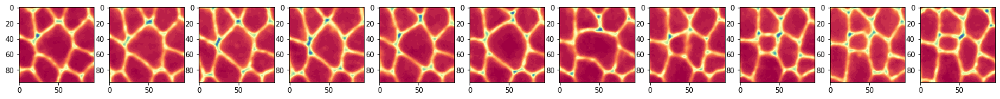

Epoch 30/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.1308 - accuracy: 0.9980 - val_loss: 2.1876 - val_accuracy: 0.9731

Epoch 00030: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


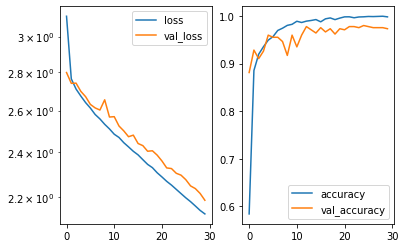

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.5046955]]
True positional value x 0.5
y [[0.5023832]]
True positional value y 0.5
t [[0.4935222]]
True positional value t 0.5
h [[0.3913736]]
True positional value h 0.40625
w [[0.594176]]
True positional value w 0.5208333333333334
c [[0.9482209]]
True positional value c 1.0


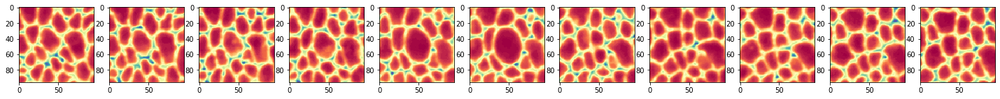

Epoch 31/250
8455/8455 [==============================] - 940s 111ms/step - loss: 2.1120 - accuracy: 0.9992 - val_loss: 2.1749 - val_accuracy: 0.9709

Epoch 00031: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


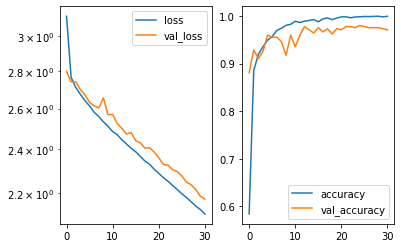

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.5151209]]
True positional value x 0.5
y [[0.5149188]]
True positional value y 0.5
t [[0.49554244]]
True positional value t 0.5
h [[0.55975956]]
True positional value h 0.5625
w [[0.4874946]]
True positional value w 0.625
c [[0.95271957]]
True positional value c 1.0


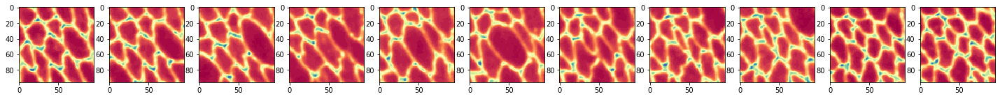

Epoch 32/250
8455/8455 [==============================] - 937s 111ms/step - loss: 2.0951 - accuracy: 0.9991 - val_loss: 2.1584 - val_accuracy: 0.9731

Epoch 00032: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


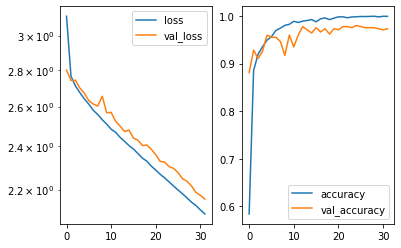

Predicted cell: Apoptosis Probability: [[0.99999964]]
True Cell type: Apoptosis
x [[0.5237978]]
True positional value x 0.5
y [[0.4930728]]
True positional value y 0.5
t [[0.49102557]]
True positional value t 0.5
h [[0.07529989]]
True positional value h 0.0625
w [[0.06854716]]
True positional value w 0.08333333333333333
c [[0.89287245]]
True positional value c 1.0


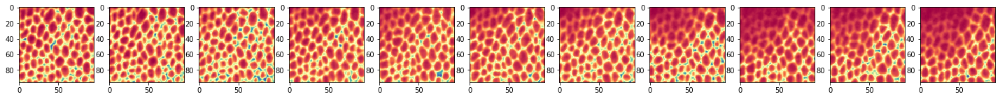

Epoch 33/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.0783 - accuracy: 0.9994 - val_loss: 2.1535 - val_accuracy: 0.9753

Epoch 00033: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


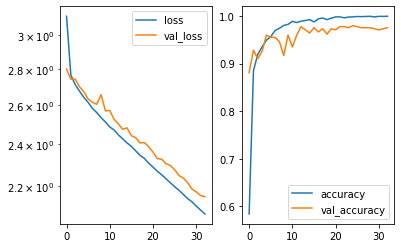

Predicted cell: Apoptosis Probability: [[0.9999975]]
True Cell type: Apoptosis
x [[0.48830828]]
True positional value x 0.5
y [[0.51731557]]
True positional value y 0.5
t [[0.49282438]]
True positional value t 0.5
h [[0.06757692]]
True positional value h 0.0625
w [[0.08117574]]
True positional value w 0.14583333333333334
c [[0.91542405]]
True positional value c 1.0


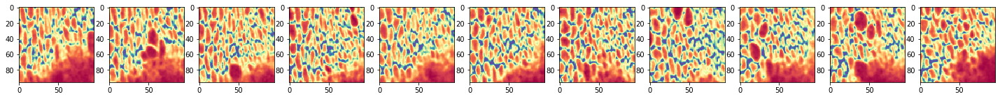

Epoch 34/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.0615 - accuracy: 0.9992 - val_loss: 2.1236 - val_accuracy: 0.9753

Epoch 00034: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


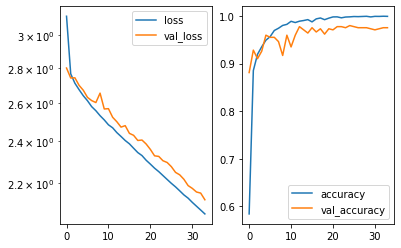

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.5218772]]
True positional value x 0.5
y [[0.4864126]]
True positional value y 0.5
t [[0.5031779]]
True positional value t 0.5
h [[0.7332921]]
True positional value h 0.6979166666666666
w [[0.5323949]]
True positional value w 0.4895833333333333
c [[0.9592555]]
True positional value c 1.0


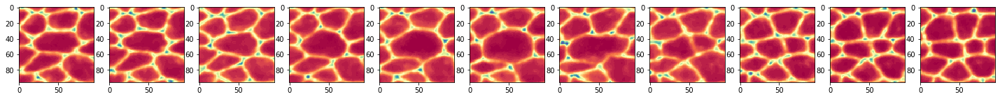

Epoch 35/250
8455/8455 [==============================] - 940s 111ms/step - loss: 2.0452 - accuracy: 0.9993 - val_loss: 2.1130 - val_accuracy: 0.9731

Epoch 00035: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


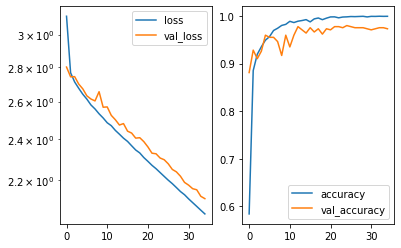

Predicted cell: Normal Probability: [[0.5259895]]
True Cell type: Apoptosis
x [[0.5044661]]
True positional value x 0.5
y [[0.498509]]
True positional value y 0.5
t [[0.49703577]]
True positional value t 0.5
h [[0.14216965]]
True positional value h 0.07291666666666667
w [[0.13586973]]
True positional value w 0.07291666666666667
c [[0.9531993]]
True positional value c 1.0


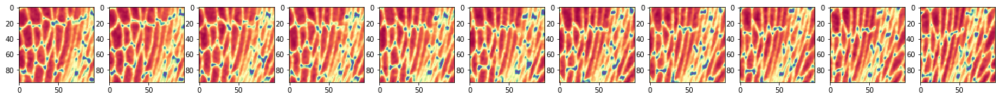

Epoch 36/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.0288 - accuracy: 0.9993 - val_loss: 2.1060 - val_accuracy: 0.9776

Epoch 00036: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


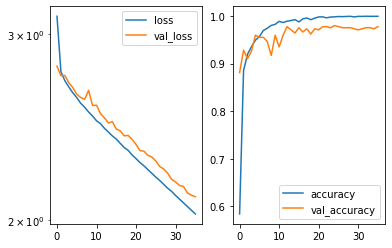

Predicted cell: Apoptosis Probability: [[0.99997973]]
True Cell type: Apoptosis
x [[0.4710602]]
True positional value x 0.5
y [[0.49574077]]
True positional value y 0.5
t [[0.51393]]
True positional value t 0.5
h [[0.08114645]]
True positional value h 0.0625
w [[0.10948982]]
True positional value w 0.0625
c [[0.89546835]]
True positional value c 1.0


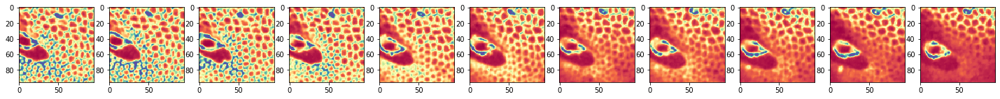

Epoch 37/250
8455/8455 [==============================] - 938s 111ms/step - loss: 2.0134 - accuracy: 0.9994 - val_loss: 2.0826 - val_accuracy: 0.9664

Epoch 00037: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


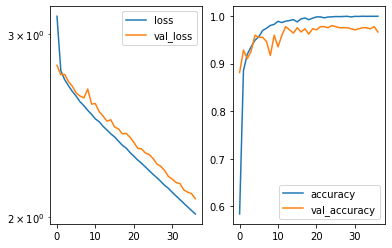

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.4817887]]
True positional value x 0.5
y [[0.49783504]]
True positional value y 0.5
t [[0.5159468]]
True positional value t 0.5
h [[0.42579207]]
True positional value h 0.4375
w [[0.39305404]]
True positional value w 0.46875
c [[0.97820675]]
True positional value c 1.0


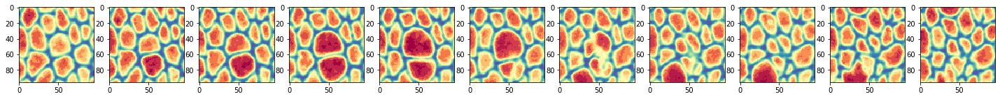

Epoch 38/250
8455/8455 [==============================] - 938s 111ms/step - loss: 1.9970 - accuracy: 0.9992 - val_loss: 2.0669 - val_accuracy: 0.9709

Epoch 00038: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


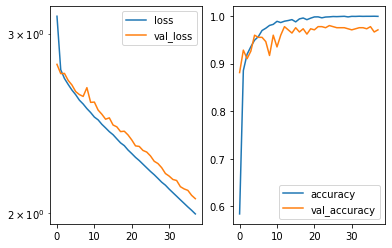

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.49446905]]
True positional value x 0.5
y [[0.5147306]]
True positional value y 0.5
t [[0.5080798]]
True positional value t 0.5
h [[0.41246533]]
True positional value h 0.4270833333333333
w [[0.5081624]]
True positional value w 0.5625
c [[0.93729705]]
True positional value c 1.0


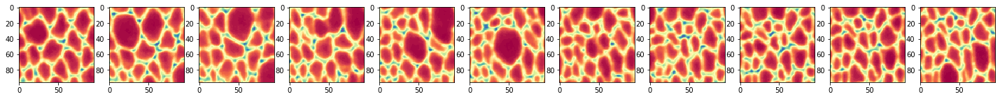

Epoch 39/250
8455/8455 [==============================] - 938s 111ms/step - loss: 1.9807 - accuracy: 0.9995 - val_loss: 2.0491 - val_accuracy: 0.9731

Epoch 00039: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


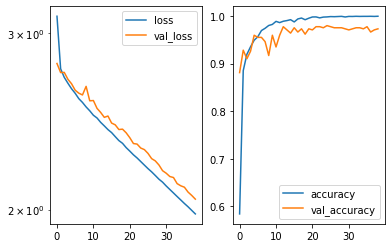

Predicted cell: Apoptosis Probability: [[0.99999785]]
True Cell type: Apoptosis
x [[0.5215315]]
True positional value x 0.5
y [[0.505319]]
True positional value y 0.5
t [[0.48809558]]
True positional value t 0.5
h [[0.19763461]]
True positional value h 0.19791666666666666
w [[0.13399105]]
True positional value w 0.11458333333333333
c [[0.8271815]]
True positional value c 1.0


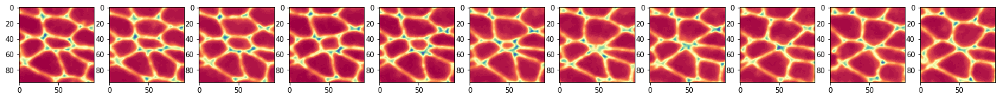

Epoch 40/250
8455/8455 [==============================] - 938s 111ms/step - loss: 1.9668 - accuracy: 0.9985 - val_loss: 2.0394 - val_accuracy: 0.9686

Epoch 00040: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


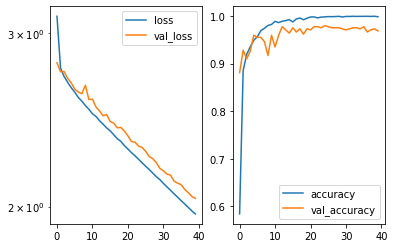

Predicted cell: Apoptosis Probability: [[0.9999397]]
True Cell type: Apoptosis
x [[0.5085789]]
True positional value x 0.5
y [[0.4925836]]
True positional value y 0.5
t [[0.51258206]]
True positional value t 0.5
h [[0.0753796]]
True positional value h 0.0625
w [[0.1063786]]
True positional value w 0.08333333333333333
c [[0.9230191]]
True positional value c 1.0


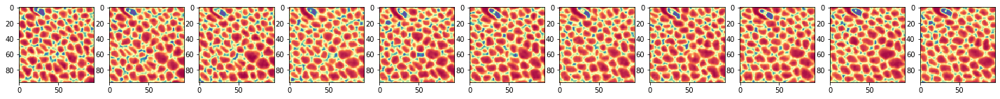

Epoch 41/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.9490 - accuracy: 0.9994 - val_loss: 2.0239 - val_accuracy: 0.9664

Epoch 00041: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


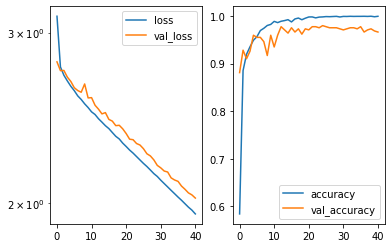

Predicted cell: Normal Probability: [[0.98431385]]
True Cell type: Normal
x [[0.52030766]]
True positional value x 0.5
y [[0.5033508]]
True positional value y 0.5
t [[0.5104695]]
True positional value t 0.5
h [[0.15786915]]
True positional value h 0.2916666666666667
w [[0.14508542]]
True positional value w 0.20833333333333334
c [[0.91732943]]
True positional value c 1.0


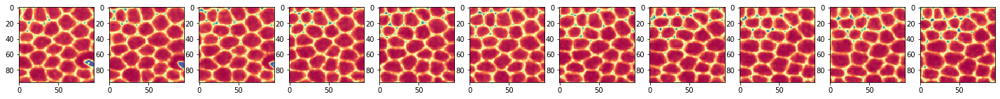

Epoch 42/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.9334 - accuracy: 0.9992 - val_loss: 2.0028 - val_accuracy: 0.9709

Epoch 00042: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


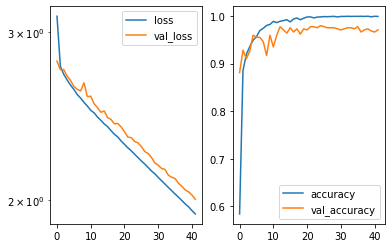

Predicted cell: Apoptosis Probability: [[0.9999844]]
True Cell type: Apoptosis
x [[0.4928312]]
True positional value x 0.5
y [[0.5071509]]
True positional value y 0.5
t [[0.5057552]]
True positional value t 0.5
h [[0.05070296]]
True positional value h 0.041666666666666664
w [[0.05590348]]
True positional value w 0.07291666666666667
c [[0.9451017]]
True positional value c 1.0


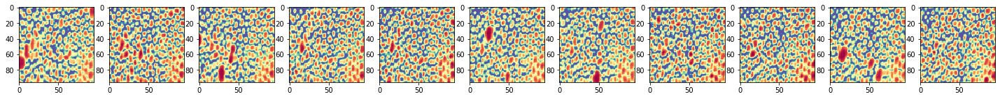

Epoch 43/250
8455/8455 [==============================] - 938s 111ms/step - loss: 1.9187 - accuracy: 0.9989 - val_loss: 1.9937 - val_accuracy: 0.9686

Epoch 00043: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


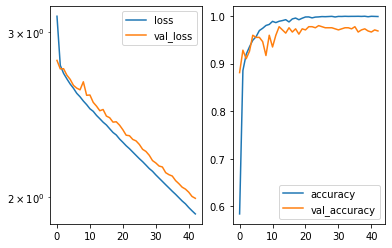

Predicted cell: Normal Probability: [[0.9999995]]
True Cell type: Normal
x [[0.5209069]]
True positional value x 0.5
y [[0.49450147]]
True positional value y 0.5
t [[0.48931873]]
True positional value t 0.5
h [[0.517925]]
True positional value h 0.6145833333333334
w [[0.5662847]]
True positional value w 0.6875
c [[0.7872593]]
True positional value c 1.0


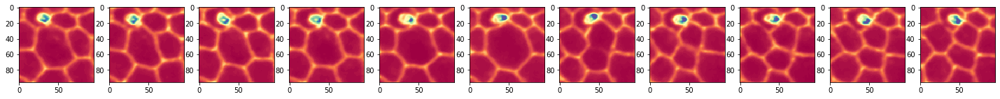

Epoch 44/250
8455/8455 [==============================] - 938s 111ms/step - loss: 1.9036 - accuracy: 0.9983 - val_loss: 2.0048 - val_accuracy: 0.9709

Epoch 00044: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


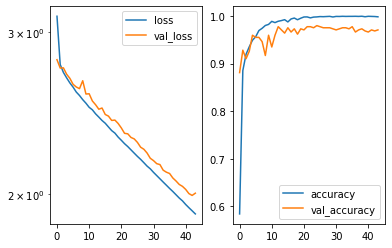

Predicted cell: Apoptosis Probability: [[0.9990534]]
True Cell type: Apoptosis
x [[0.51255363]]
True positional value x 0.5
y [[0.502022]]
True positional value y 0.5
t [[0.48199832]]
True positional value t 0.5
h [[0.04900663]]
True positional value h 0.0625
w [[0.06872955]]
True positional value w 0.07291666666666667
c [[0.9933361]]
True positional value c 1.0


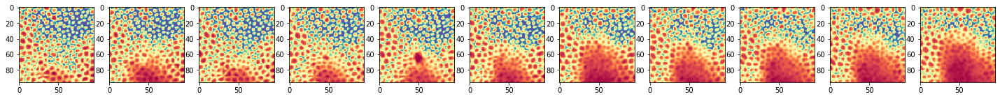

Epoch 45/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.8962 - accuracy: 0.9910 - val_loss: 2.0050 - val_accuracy: 0.9709

Epoch 00045: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


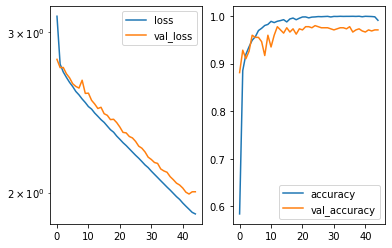

Predicted cell: Normal Probability: [[0.50923383]]
True Cell type: Apoptosis
x [[0.5023326]]
True positional value x 0.5
y [[0.49237946]]
True positional value y 0.5
t [[0.49709085]]
True positional value t 0.5
h [[0.10242128]]
True positional value h 0.041666666666666664
w [[0.15085039]]
True positional value w 0.041666666666666664
c [[0.7598586]]
True positional value c 1.0


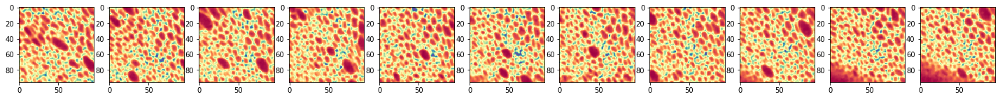

Epoch 46/250
8455/8455 [==============================] - 940s 111ms/step - loss: 1.8862 - accuracy: 0.9878 - val_loss: 1.9492 - val_accuracy: 0.9686

Epoch 00046: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


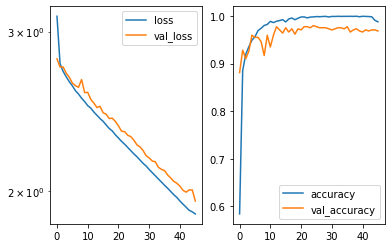

Predicted cell: Normal Probability: [[0.99999964]]
True Cell type: Normal
x [[0.5270126]]
True positional value x 0.5
y [[0.49055642]]
True positional value y 0.5
t [[0.5041237]]
True positional value t 0.5
h [[0.2637767]]
True positional value h 0.3541666666666667
w [[0.577594]]
True positional value w 0.8958333333333334
c [[0.92330265]]
True positional value c 1.0


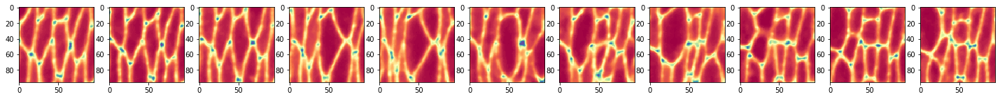

Epoch 47/250
8455/8455 [==============================] - 940s 111ms/step - loss: 1.8646 - accuracy: 0.9940 - val_loss: 1.9465 - val_accuracy: 0.9753

Epoch 00047: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


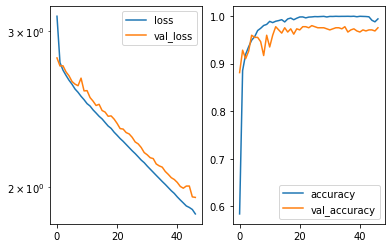

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.5177822]]
True positional value x 0.5
y [[0.5077739]]
True positional value y 0.5
t [[0.49592635]]
True positional value t 0.5
h [[0.37431076]]
True positional value h 0.5
w [[0.57915676]]
True positional value w 0.625
c [[0.9847127]]
True positional value c 1.0


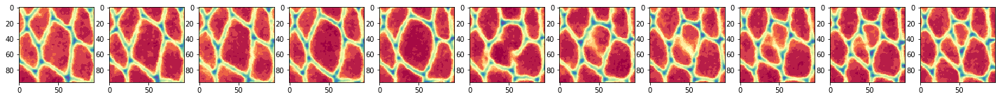

Epoch 48/250
8455/8455 [==============================] - 947s 112ms/step - loss: 1.8461 - accuracy: 0.9970 - val_loss: 1.9321 - val_accuracy: 0.9664

Epoch 00048: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


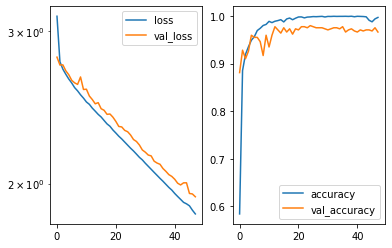

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.50026774]]
True positional value x 0.5
y [[0.5046404]]
True positional value y 0.5
t [[0.5111501]]
True positional value t 0.5
h [[0.38199788]]
True positional value h 0.3645833333333333
w [[0.48324126]]
True positional value w 0.5833333333333334
c [[0.98340005]]
True positional value c 1.0


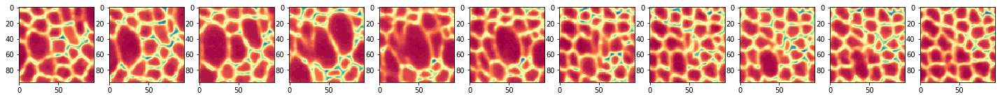

Epoch 49/250
8455/8455 [==============================] - 946s 112ms/step - loss: 1.8275 - accuracy: 0.9969 - val_loss: 1.9113 - val_accuracy: 0.9686

Epoch 00049: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


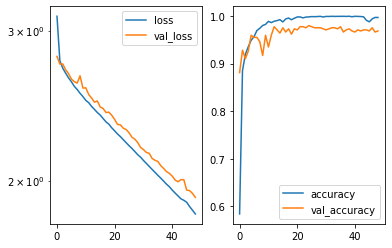

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.48871994]]
True positional value x 0.5
y [[0.5119198]]
True positional value y 0.5
t [[0.48883295]]
True positional value t 0.5
h [[0.32261696]]
True positional value h 0.3854166666666667
w [[0.48860973]]
True positional value w 0.4166666666666667
c [[0.98328847]]
True positional value c 1.0


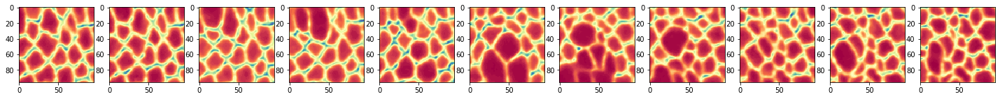

Epoch 50/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.8120 - accuracy: 0.9952 - val_loss: 1.8968 - val_accuracy: 0.9731

Epoch 00050: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


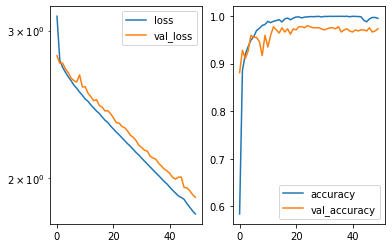

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.5082309]]
True positional value x 0.5
y [[0.49447197]]
True positional value y 0.5
t [[0.50002414]]
True positional value t 0.5
h [[0.5122702]]
True positional value h 0.6041666666666666
w [[0.6638946]]
True positional value w 0.65625
c [[0.9621198]]
True positional value c 1.0


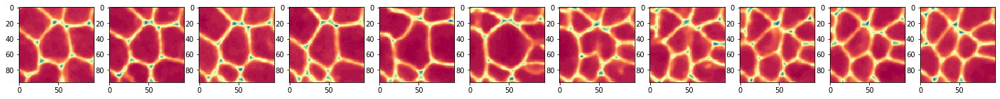

Epoch 51/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.7962 - accuracy: 0.9938 - val_loss: 1.8849 - val_accuracy: 0.9596

Epoch 00051: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


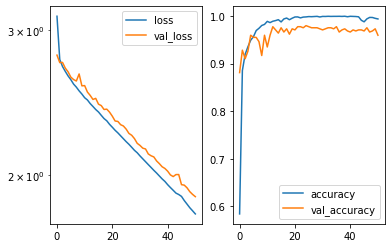

Predicted cell: Normal Probability: [[0.9999933]]
True Cell type: Normal
x [[0.49673533]]
True positional value x 0.5
y [[0.5053636]]
True positional value y 0.5
t [[0.49163714]]
True positional value t 0.5
h [[0.551334]]
True positional value h 0.5833333333333334
w [[0.4752774]]
True positional value w 0.4895833333333333
c [[0.99736005]]
True positional value c 1.0


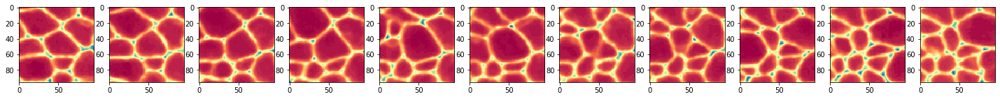

Epoch 52/250
8455/8455 [==============================] - 940s 111ms/step - loss: 1.7824 - accuracy: 0.9930 - val_loss: 1.8802 - val_accuracy: 0.9709

Epoch 00052: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


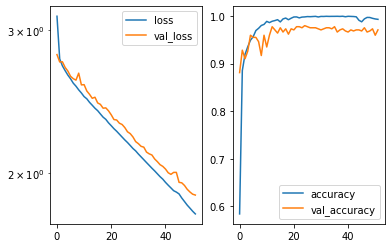

Predicted cell: Apoptosis Probability: [[0.9999999]]
True Cell type: Apoptosis
x [[0.4966032]]
True positional value x 0.5
y [[0.48815513]]
True positional value y 0.5
t [[0.51311374]]
True positional value t 0.5
h [[0.05091662]]
True positional value h 0.052083333333333336
w [[0.06318907]]
True positional value w 0.052083333333333336
c [[0.9136317]]
True positional value c 1.0


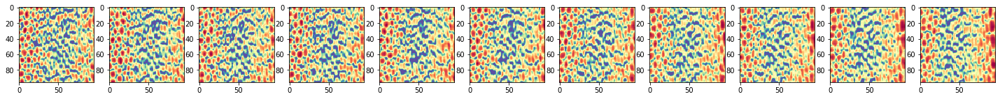

Epoch 53/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.7763 - accuracy: 0.9834 - val_loss: 1.8812 - val_accuracy: 0.9574

Epoch 00053: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


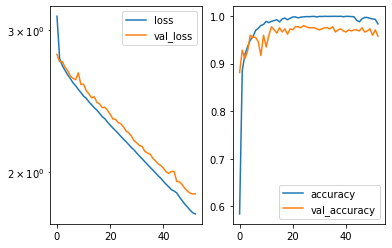

Predicted cell: Apoptosis Probability: [[1.]]
True Cell type: Apoptosis
x [[0.4946007]]
True positional value x 0.5
y [[0.5000417]]
True positional value y 0.5
t [[0.49953458]]
True positional value t 0.5
h [[0.04549691]]
True positional value h 0.052083333333333336
w [[0.04001563]]
True positional value w 0.052083333333333336
c [[0.99873]]
True positional value c 1.0


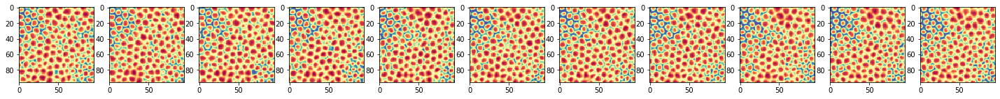

Epoch 54/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.7720 - accuracy: 0.9794 - val_loss: 1.8413 - val_accuracy: 0.9709

Epoch 00054: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


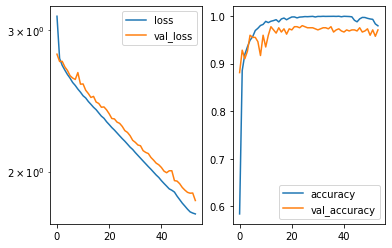

Predicted cell: Apoptosis Probability: [[0.9999981]]
True Cell type: Apoptosis
x [[0.48191258]]
True positional value x 0.5
y [[0.49925956]]
True positional value y 0.5
t [[0.49667814]]
True positional value t 0.5
h [[0.04819025]]
True positional value h 0.041666666666666664
w [[0.05988968]]
True positional value w 0.0625
c [[0.98196995]]
True positional value c 1.0


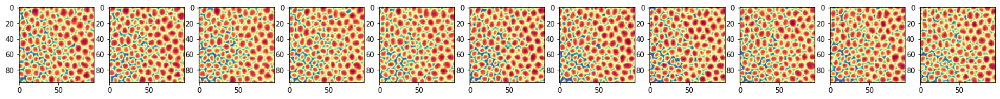

Epoch 55/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.7467 - accuracy: 0.9876 - val_loss: 1.8548 - val_accuracy: 0.9596

Epoch 00055: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


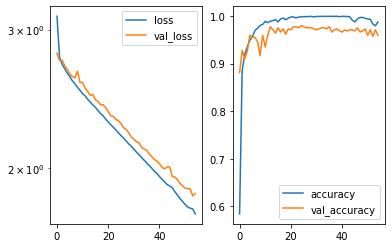

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.49440843]]
True positional value x 0.5
y [[0.501863]]
True positional value y 0.5
t [[0.5067314]]
True positional value t 0.5
h [[0.3263882]]
True positional value h 0.3333333333333333
w [[0.58275354]]
True positional value w 0.5729166666666666
c [[0.99259514]]
True positional value c 1.0


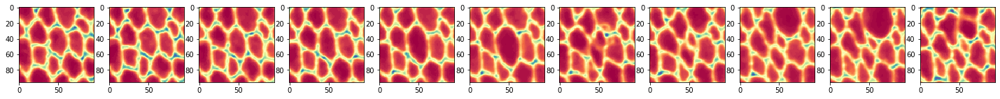

Epoch 56/250
8455/8455 [==============================] - 940s 111ms/step - loss: 1.7327 - accuracy: 0.9831 - val_loss: 1.8183 - val_accuracy: 0.9507

Epoch 00056: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


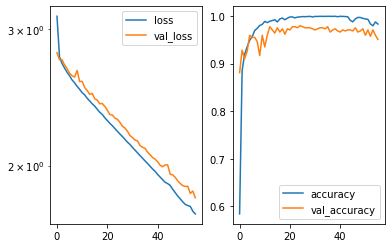

Predicted cell: Normal Probability: [[0.99999964]]
True Cell type: Normal
x [[0.49896508]]
True positional value x 0.5
y [[0.50761396]]
True positional value y 0.5
t [[0.493834]]
True positional value t 0.5
h [[0.19740805]]
True positional value h 0.10416666666666667
w [[0.28718975]]
True positional value w 0.10416666666666667
c [[0.7690089]]
True positional value c 0.0


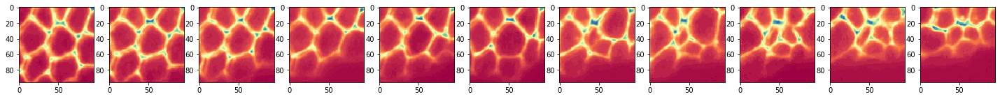

Epoch 57/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.7202 - accuracy: 0.9833 - val_loss: 1.8184 - val_accuracy: 0.9619

Epoch 00057: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


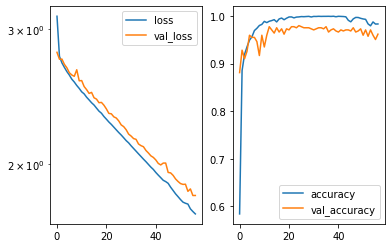

Predicted cell: Apoptosis Probability: [[0.9999982]]
True Cell type: Apoptosis
x [[0.50188196]]
True positional value x 0.5
y [[0.5034724]]
True positional value y 0.5
t [[0.49540702]]
True positional value t 0.5
h [[0.04531132]]
True positional value h 0.041666666666666664
w [[0.04963696]]
True positional value w 0.041666666666666664
c [[0.9205137]]
True positional value c 1.0


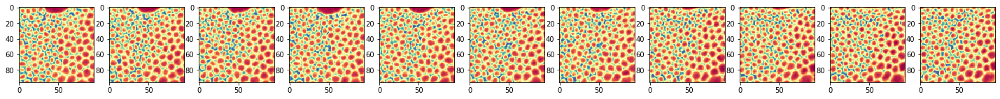

Epoch 58/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.7028 - accuracy: 0.9876 - val_loss: 1.8088 - val_accuracy: 0.9596

Epoch 00058: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


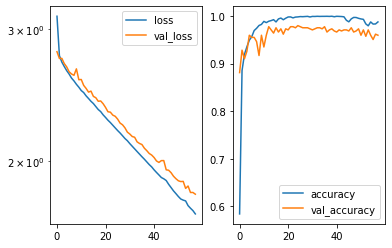

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.49683607]]
True positional value x 0.5
y [[0.5041835]]
True positional value y 0.5
t [[0.48880902]]
True positional value t 0.5
h [[0.35275468]]
True positional value h 0.40625
w [[0.4221054]]
True positional value w 0.4375
c [[0.9256817]]
True positional value c 1.0


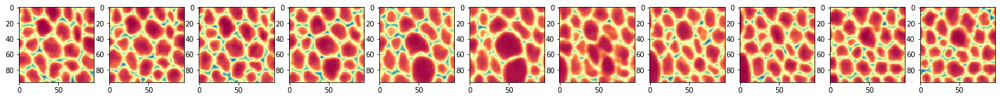

Epoch 59/250
8455/8455 [==============================] - 939s 111ms/step - loss: 1.6892 - accuracy: 0.9853 - val_loss: 1.7986 - val_accuracy: 0.9439

Epoch 00059: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


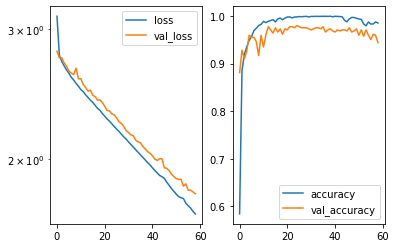

Predicted cell: Normal Probability: [[0.999998]]
True Cell type: Normal
x [[0.4972307]]
True positional value x 0.5
y [[0.49434632]]
True positional value y 0.5
t [[0.4984123]]
True positional value t 0.5
h [[0.5762286]]
True positional value h 0.6354166666666666
w [[0.6222316]]
True positional value w 0.9583333333333334
c [[0.99029267]]
True positional value c 1.0


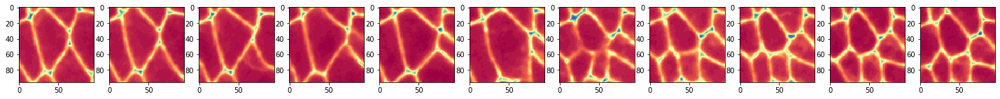

Epoch 60/250
8455/8455 [==============================] - 940s 111ms/step - loss: 1.6748 - accuracy: 0.9864 - val_loss: 1.7816 - val_accuracy: 0.9552

Epoch 00060: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


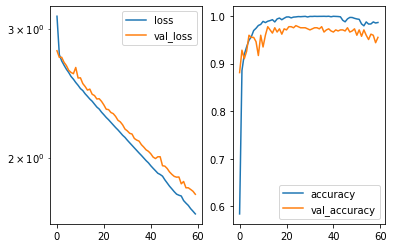

Predicted cell: Apoptosis Probability: [[0.9991702]]
True Cell type: Apoptosis
x [[0.5012389]]
True positional value x 0.5
y [[0.50596416]]
True positional value y 0.5
t [[0.49828205]]
True positional value t 0.5
h [[0.0547252]]
True positional value h 0.07291666666666667
w [[0.07786082]]
True positional value w 0.0625
c [[0.9922924]]
True positional value c 1.0


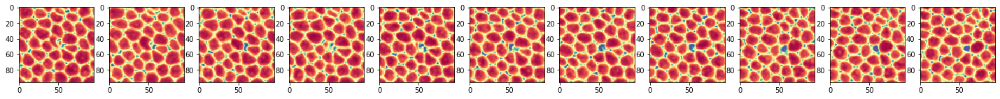

Epoch 61/250
8455/8455 [==============================] - 938s 111ms/step - loss: 1.6618 - accuracy: 0.9840 - val_loss: 1.7597 - val_accuracy: 0.9372

Epoch 00061: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


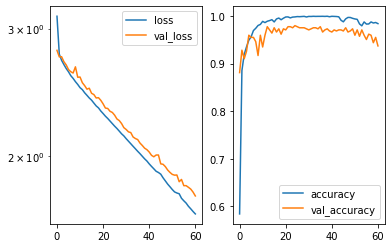

Predicted cell: Apoptosis Probability: [[1.]]
True Cell type: Apoptosis
x [[0.49473116]]
True positional value x 0.5
y [[0.50064814]]
True positional value y 0.5
t [[0.4930222]]
True positional value t 0.5
h [[0.03597572]]
True positional value h 0.10416666666666667
w [[0.04587831]]
True positional value w 0.10416666666666667
c [[0.9992867]]
True positional value c 0.0


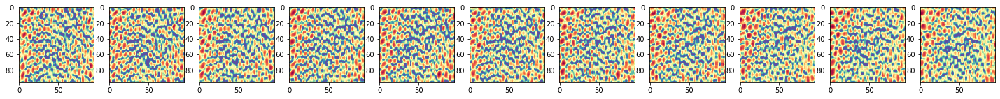

Epoch 62/250
8455/8455 [==============================] - 942s 111ms/step - loss: 1.6501 - accuracy: 0.9776 - val_loss: 1.7272 - val_accuracy: 0.9484

Epoch 00062: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


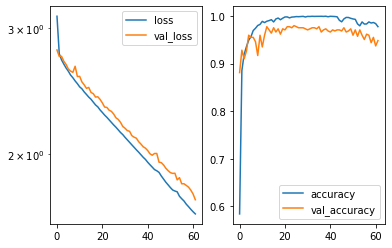

Predicted cell: Apoptosis Probability: [[0.99542075]]
True Cell type: Apoptosis
x [[0.5013298]]
True positional value x 0.5
y [[0.4929824]]
True positional value y 0.5
t [[0.49966678]]
True positional value t 0.5
h [[0.08154514]]
True positional value h 0.041666666666666664
w [[0.1113932]]
True positional value w 0.041666666666666664
c [[0.9943575]]
True positional value c 1.0


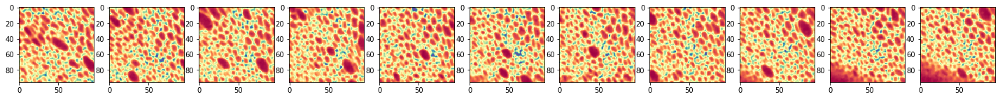

Epoch 63/250
8455/8455 [==============================] - 942s 111ms/step - loss: 1.6362 - accuracy: 0.9842 - val_loss: 1.7160 - val_accuracy: 0.9484

Epoch 00063: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


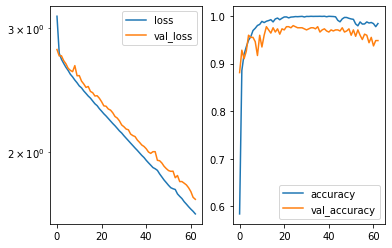

Predicted cell: Apoptosis Probability: [[0.9999658]]
True Cell type: Apoptosis
x [[0.51064163]]
True positional value x 0.5
y [[0.49564844]]
True positional value y 0.5
t [[0.4874886]]
True positional value t 0.5
h [[0.08555885]]
True positional value h 0.10416666666666667
w [[0.06331068]]
True positional value w 0.13541666666666666
c [[0.99581933]]
True positional value c 1.0


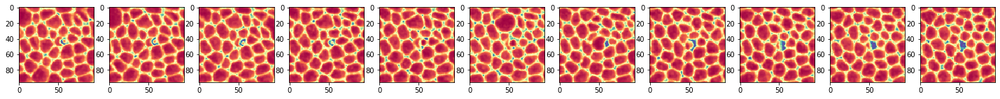

Epoch 64/250
8455/8455 [==============================] - 940s 111ms/step - loss: 1.6239 - accuracy: 0.9833 - val_loss: 1.7078 - val_accuracy: 0.9484

Epoch 00064: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


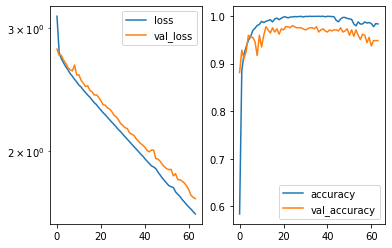

Predicted cell: Apoptosis Probability: [[0.99999714]]
True Cell type: Apoptosis
x [[0.4934819]]
True positional value x 0.5
y [[0.49686903]]
True positional value y 0.5
t [[0.49722102]]
True positional value t 0.5
h [[0.05538656]]
True positional value h 0.041666666666666664
w [[0.06775872]]
True positional value w 0.0625
c [[0.89438033]]
True positional value c 1.0


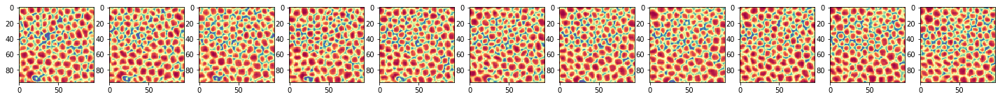

Epoch 65/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.6105 - accuracy: 0.9842 - val_loss: 1.6925 - val_accuracy: 0.9462

Epoch 00065: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


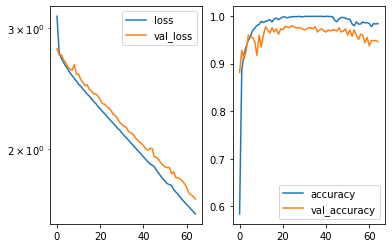

Predicted cell: Apoptosis Probability: [[0.99999857]]
True Cell type: Apoptosis
x [[0.5007798]]
True positional value x 0.5
y [[0.4955592]]
True positional value y 0.5
t [[0.49723554]]
True positional value t 0.5
h [[0.07367849]]
True positional value h 0.10416666666666667
w [[0.07878964]]
True positional value w 0.10416666666666667
c [[0.9949857]]
True positional value c 0.0


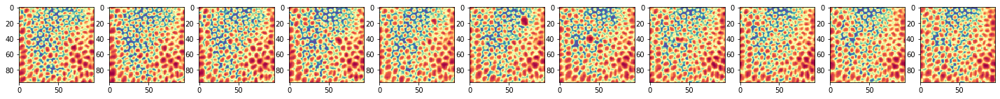

Epoch 66/250
8455/8455 [==============================] - 940s 111ms/step - loss: 1.5984 - accuracy: 0.9850 - val_loss: 1.6837 - val_accuracy: 0.9484

Epoch 00066: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


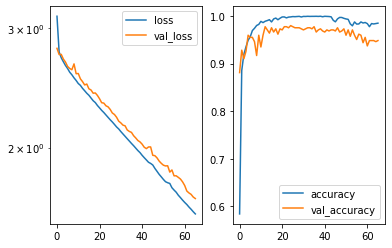

Predicted cell: Normal Probability: [[0.9791205]]
True Cell type: Normal
x [[0.500103]]
True positional value x 0.5
y [[0.50447863]]
True positional value y 0.5
t [[0.49569783]]
True positional value t 0.5
h [[0.15172556]]
True positional value h 0.16666666666666666
w [[0.13486004]]
True positional value w 0.15625
c [[0.988701]]
True positional value c 1.0


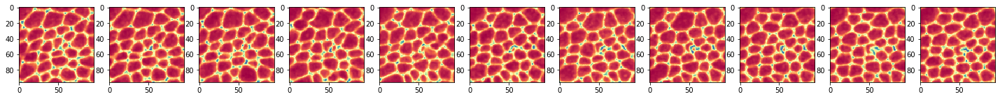

Epoch 67/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.5873 - accuracy: 0.9782 - val_loss: 1.6772 - val_accuracy: 0.9126

Epoch 00067: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


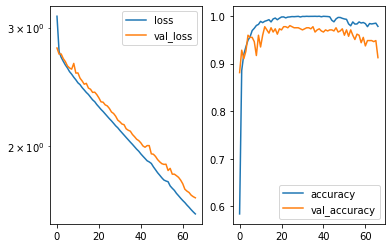

Predicted cell: Normal Probability: [[0.99999964]]
True Cell type: Normal
x [[0.49716952]]
True positional value x 0.5
y [[0.5043992]]
True positional value y 0.5
t [[0.5019324]]
True positional value t 0.5
h [[0.31580532]]
True positional value h 0.3125
w [[0.41856414]]
True positional value w 0.46875
c [[0.9985405]]
True positional value c 1.0


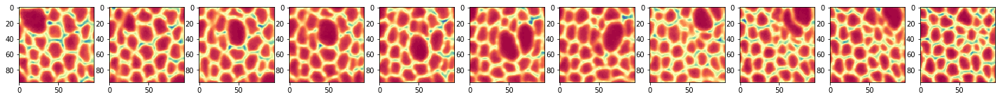

Epoch 68/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.5756 - accuracy: 0.9815 - val_loss: 1.6553 - val_accuracy: 0.9395

Epoch 00068: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


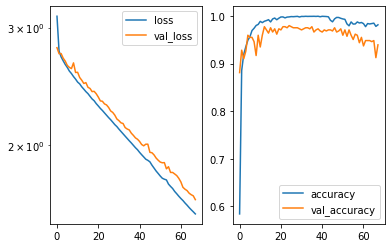

Predicted cell: Apoptosis Probability: [[1.]]
True Cell type: Apoptosis
x [[0.50005007]]
True positional value x 0.5
y [[0.5017866]]
True positional value y 0.5
t [[0.5018435]]
True positional value t 0.5
h [[0.04973087]]
True positional value h 0.0625
w [[0.07812794]]
True positional value w 0.08333333333333333
c [[0.91499215]]
True positional value c 1.0


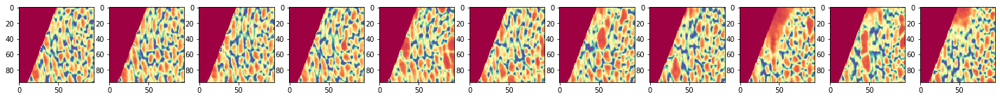

Epoch 69/250
8455/8455 [==============================] - 942s 111ms/step - loss: 1.5638 - accuracy: 0.9817 - val_loss: 1.6518 - val_accuracy: 0.9350

Epoch 00069: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


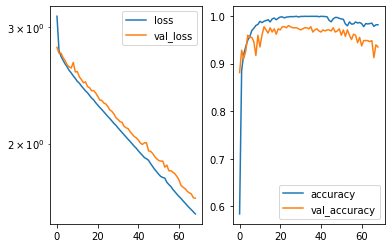

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.5010853]]
True positional value x 0.5
y [[0.4903184]]
True positional value y 0.5
t [[0.50841933]]
True positional value t 0.5
h [[0.7183781]]
True positional value h 0.6979166666666666
w [[0.50270176]]
True positional value w 0.4895833333333333
c [[0.9874291]]
True positional value c 1.0


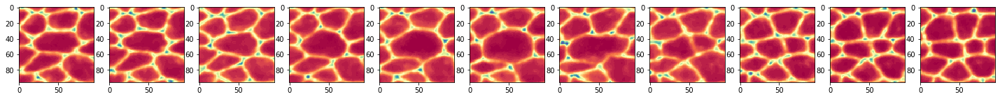

Epoch 70/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.5523 - accuracy: 0.9836 - val_loss: 1.6462 - val_accuracy: 0.9462

Epoch 00070: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


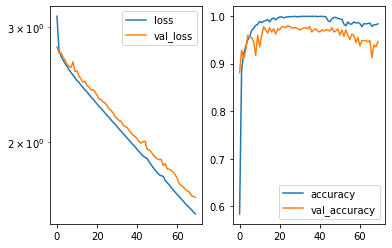

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.5031345]]
True positional value x 0.5
y [[0.50957143]]
True positional value y 0.5
t [[0.49319726]]
True positional value t 0.5
h [[0.33439913]]
True positional value h 0.3541666666666667
w [[0.51244503]]
True positional value w 0.4791666666666667
c [[0.9623962]]
True positional value c 1.0


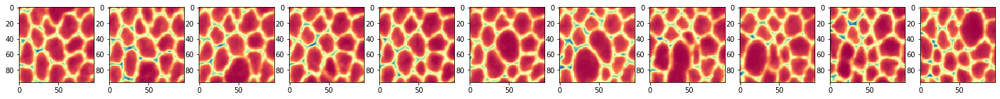

Epoch 71/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.5411 - accuracy: 0.9830 - val_loss: 1.6361 - val_accuracy: 0.9372

Epoch 00071: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


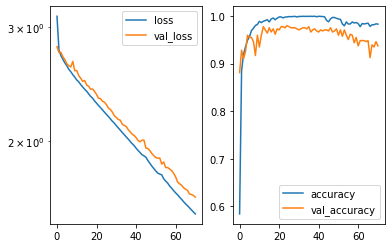

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.4961096]]
True positional value x 0.5
y [[0.50131977]]
True positional value y 0.5
t [[0.50820786]]
True positional value t 0.5
h [[0.4336967]]
True positional value h 0.28125
w [[0.45018706]]
True positional value w 0.4479166666666667
c [[0.999941]]
True positional value c 1.0


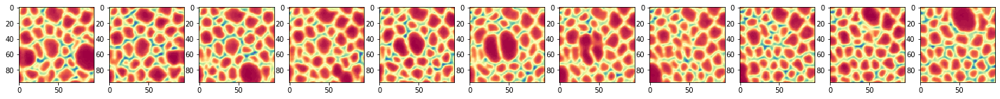

Epoch 72/250
8455/8455 [==============================] - 942s 111ms/step - loss: 1.5290 - accuracy: 0.9788 - val_loss: 1.6184 - val_accuracy: 0.9529

Epoch 00072: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


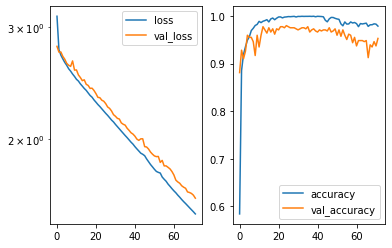

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.49658284]]
True positional value x 0.5
y [[0.4957768]]
True positional value y 0.5
t [[0.50308144]]
True positional value t 0.5
h [[0.6070229]]
True positional value h 0.5520833333333334
w [[0.65587896]]
True positional value w 0.59375
c [[0.9993987]]
True positional value c 1.0


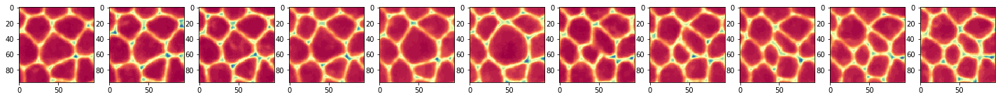

Epoch 73/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.5170 - accuracy: 0.9752 - val_loss: 1.6077 - val_accuracy: 0.9350

Epoch 00073: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


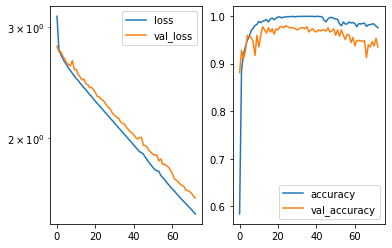

Predicted cell: Normal Probability: [[0.9533179]]
True Cell type: Normal
x [[0.49950445]]
True positional value x 0.5
y [[0.5000489]]
True positional value y 0.5
t [[0.4964188]]
True positional value t 0.5
h [[0.12463819]]
True positional value h 0.2604166666666667
w [[0.15465282]]
True positional value w 0.25
c [[0.99647576]]
True positional value c 1.0


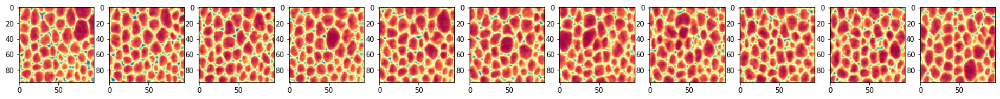

Epoch 74/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.5060 - accuracy: 0.9834 - val_loss: 1.5936 - val_accuracy: 0.9417

Epoch 00074: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


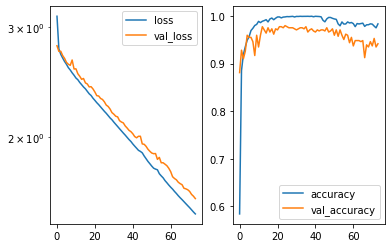

Predicted cell: Apoptosis Probability: [[0.99998486]]
True Cell type: Apoptosis
x [[0.50017494]]
True positional value x 0.5
y [[0.50421035]]
True positional value y 0.5
t [[0.5013065]]
True positional value t 0.5
h [[0.06226783]]
True positional value h 0.08333333333333333
w [[0.06040284]]
True positional value w 0.09375
c [[0.99893504]]
True positional value c 1.0


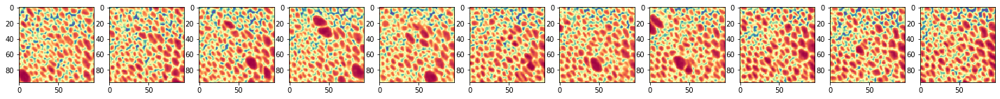

Epoch 75/250
8455/8455 [==============================] - 941s 111ms/step - loss: 1.4946 - accuracy: 0.9807 - val_loss: 1.5852 - val_accuracy: 0.9395

Epoch 00075: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


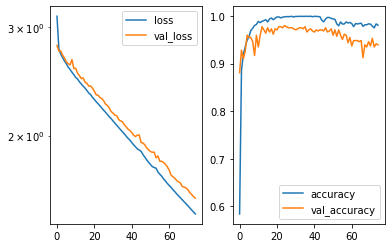

Predicted cell: Normal Probability: [[0.9999925]]
True Cell type: Normal
x [[0.49579516]]
True positional value x 0.5
y [[0.49980244]]
True positional value y 0.5
t [[0.4998327]]
True positional value t 0.5
h [[0.39722827]]
True positional value h 0.375
w [[0.6296915]]
True positional value w 0.7604166666666666
c [[0.9944781]]
True positional value c 1.0


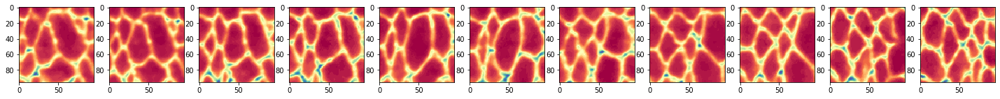

Epoch 76/250
8455/8455 [==============================] - 956s 113ms/step - loss: 1.4842 - accuracy: 0.9781 - val_loss: 1.5699 - val_accuracy: 0.9372

Epoch 00076: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


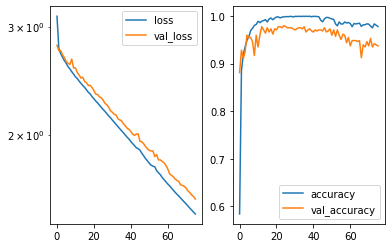

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.5006403]]
True positional value x 0.5
y [[0.5002986]]
True positional value y 0.5
t [[0.49404317]]
True positional value t 0.5
h [[0.3843987]]
True positional value h 0.3229166666666667
w [[0.2777217]]
True positional value w 0.2708333333333333
c [[0.9987601]]
True positional value c 1.0


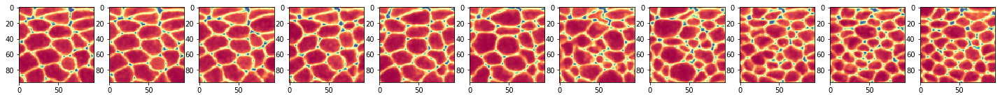

Epoch 77/250
8455/8455 [==============================] - 958s 113ms/step - loss: 1.4733 - accuracy: 0.9813 - val_loss: 1.5628 - val_accuracy: 0.9417

Epoch 00077: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


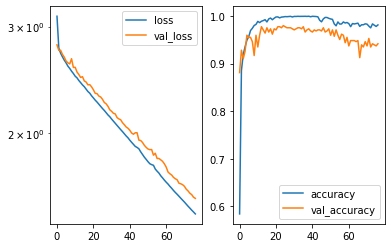

Predicted cell: Apoptosis Probability: [[0.58315414]]
True Cell type: Normal
x [[0.4970651]]
True positional value x 0.5
y [[0.49160016]]
True positional value y 0.5
t [[0.4982483]]
True positional value t 0.5
h [[0.13076283]]
True positional value h 0.14583333333333334
w [[0.1885685]]
True positional value w 0.19791666666666666
c [[0.9982663]]
True positional value c 1.0


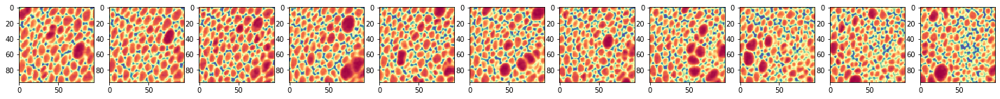

Epoch 78/250
8455/8455 [==============================] - 956s 113ms/step - loss: 1.4623 - accuracy: 0.9801 - val_loss: 1.5526 - val_accuracy: 0.9395

Epoch 00078: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


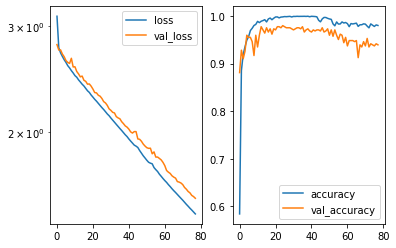

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.49652147]]
True positional value x 0.5
y [[0.5013159]]
True positional value y 0.5
t [[0.49606353]]
True positional value t 0.5
h [[0.35159636]]
True positional value h 0.3645833333333333
w [[0.5591038]]
True positional value w 0.5625
c [[0.98123944]]
True positional value c 1.0


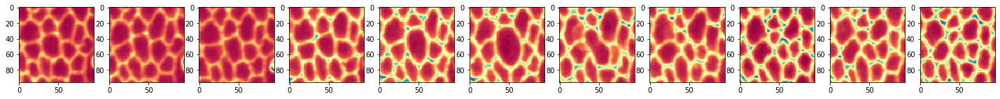

Epoch 79/250
8455/8455 [==============================] - 954s 113ms/step - loss: 1.4522 - accuracy: 0.9776 - val_loss: 1.5412 - val_accuracy: 0.9260

Epoch 00079: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


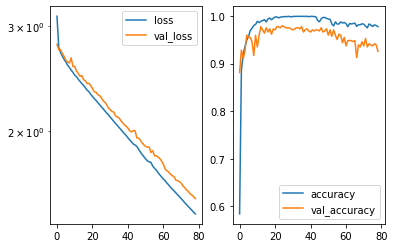

Predicted cell: Apoptosis Probability: [[0.99997926]]
True Cell type: Apoptosis
x [[0.5027452]]
True positional value x 0.5
y [[0.5026504]]
True positional value y 0.5
t [[0.5011303]]
True positional value t 0.5
h [[0.09381595]]
True positional value h 0.0625
w [[0.10643394]]
True positional value w 0.08333333333333333
c [[0.8757788]]
True positional value c 1.0


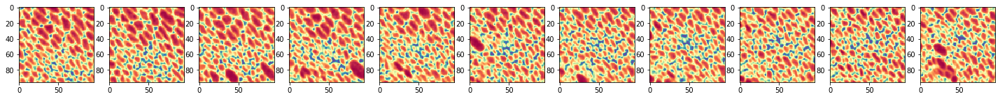

Epoch 80/250
8455/8455 [==============================] - 955s 113ms/step - loss: 1.4420 - accuracy: 0.9813 - val_loss: 1.5290 - val_accuracy: 0.9484

Epoch 00080: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


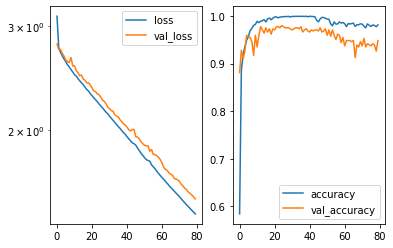

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.50263196]]
True positional value x 0.5
y [[0.5027409]]
True positional value y 0.5
t [[0.49688193]]
True positional value t 0.5
h [[0.4543161]]
True positional value h 0.4166666666666667
w [[0.53318506]]
True positional value w 0.5208333333333334
c [[0.99913603]]
True positional value c 1.0


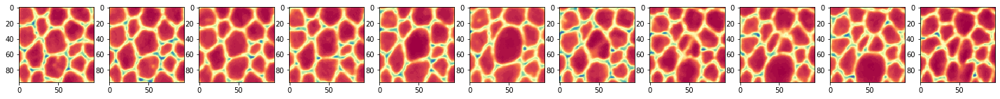

Epoch 81/250
8455/8455 [==============================] - 946s 112ms/step - loss: 1.4306 - accuracy: 0.9759 - val_loss: 1.5223 - val_accuracy: 0.9395

Epoch 00081: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


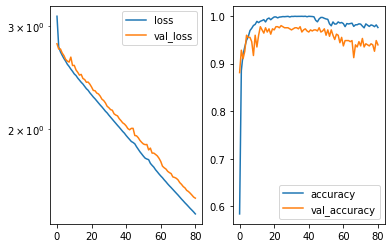

Predicted cell: Normal Probability: [[0.99999774]]
True Cell type: Normal
x [[0.50572866]]
True positional value x 0.5
y [[0.50298524]]
True positional value y 0.5
t [[0.4939032]]
True positional value t 0.5
h [[0.81972516]]
True positional value h 0.8229166666666666
w [[0.56402534]]
True positional value w 0.59375
c [[0.9999188]]
True positional value c 1.0


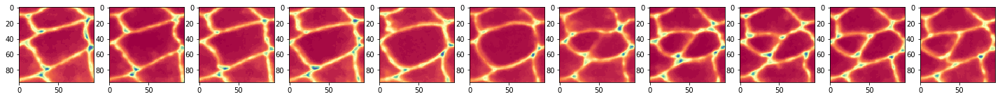

Epoch 82/250
8455/8455 [==============================] - 961s 114ms/step - loss: 1.4215 - accuracy: 0.9772 - val_loss: 1.5061 - val_accuracy: 0.9417

Epoch 00082: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


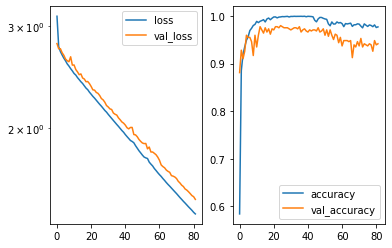

Predicted cell: Normal Probability: [[0.9999995]]
True Cell type: Normal
x [[0.49845862]]
True positional value x 0.5
y [[0.5002735]]
True positional value y 0.5
t [[0.50063896]]
True positional value t 0.5
h [[0.32853082]]
True positional value h 0.3125
w [[0.43392164]]
True positional value w 0.46875
c [[0.9984565]]
True positional value c 1.0


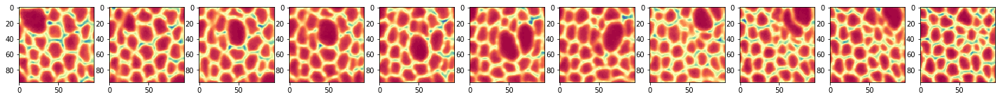

Epoch 83/250
8455/8455 [==============================] - 948s 112ms/step - loss: 1.4104 - accuracy: 0.9736 - val_loss: 1.5011 - val_accuracy: 0.9372

Epoch 00083: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


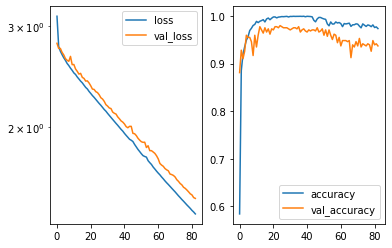

Predicted cell: Apoptosis Probability: [[1.]]
True Cell type: Apoptosis
x [[0.4964718]]
True positional value x 0.5
y [[0.5003714]]
True positional value y 0.5
t [[0.5035244]]
True positional value t 0.5
h [[0.04839792]]
True positional value h 0.07291666666666667
w [[0.05194186]]
True positional value w 0.09375
c [[0.99825364]]
True positional value c 1.0


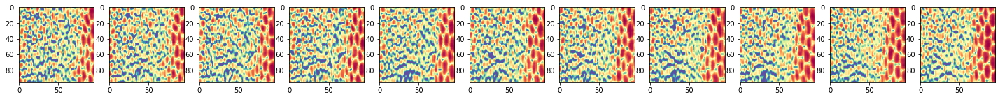

Epoch 84/250
8455/8455 [==============================] - 947s 112ms/step - loss: 1.4003 - accuracy: 0.9795 - val_loss: 1.4858 - val_accuracy: 0.9372

Epoch 00084: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


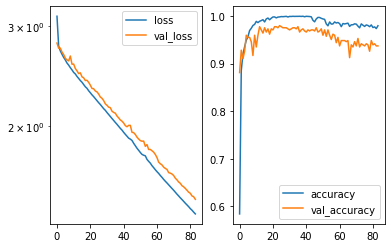

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.50471896]]
True positional value x 0.5
y [[0.5021744]]
True positional value y 0.5
t [[0.50414085]]
True positional value t 0.5
h [[0.4972696]]
True positional value h 0.5
w [[0.725438]]
True positional value w 0.625
c [[0.9994824]]
True positional value c 1.0


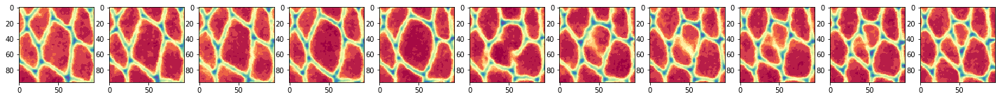

Epoch 85/250
8455/8455 [==============================] - 945s 112ms/step - loss: 1.3901 - accuracy: 0.9732 - val_loss: 1.4778 - val_accuracy: 0.9260

Epoch 00085: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


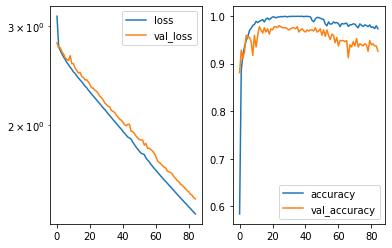

Predicted cell: Normal Probability: [[0.9999987]]
True Cell type: Normal
x [[0.5025221]]
True positional value x 0.5
y [[0.5001088]]
True positional value y 0.5
t [[0.5016934]]
True positional value t 0.5
h [[0.20241182]]
True positional value h 0.1875
w [[0.25690663]]
True positional value w 0.28125
c [[0.9996524]]
True positional value c 1.0


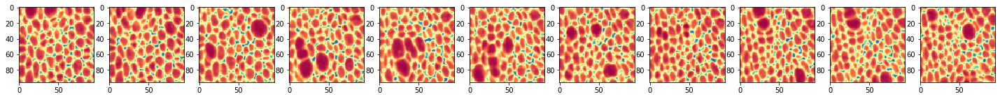

Epoch 86/250
8455/8455 [==============================] - 945s 112ms/step - loss: 1.3809 - accuracy: 0.9730 - val_loss: 1.4668 - val_accuracy: 0.9350

Epoch 00086: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


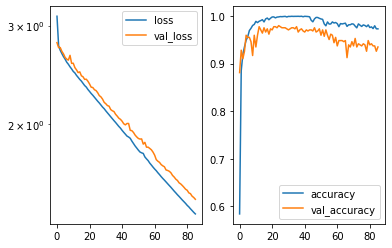

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.49812487]]
True positional value x 0.5
y [[0.49647546]]
True positional value y 0.5
t [[0.50483334]]
True positional value t 0.5
h [[0.44560137]]
True positional value h 0.4375
w [[0.60952115]]
True positional value w 0.5833333333333334
c [[0.9996469]]
True positional value c 1.0


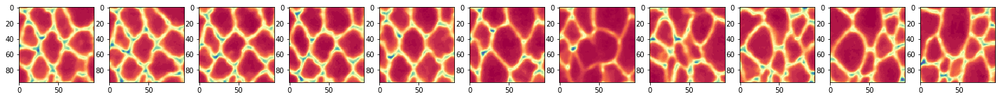

Epoch 87/250
8455/8455 [==============================] - 946s 112ms/step - loss: 1.3700 - accuracy: 0.9767 - val_loss: 1.4578 - val_accuracy: 0.9350

Epoch 00087: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


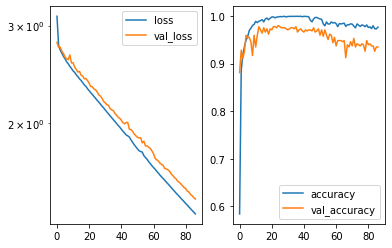

Predicted cell: Apoptosis Probability: [[0.9999993]]
True Cell type: Apoptosis
x [[0.49806252]]
True positional value x 0.5
y [[0.50099826]]
True positional value y 0.5
t [[0.5008063]]
True positional value t 0.5
h [[0.05840359]]
True positional value h 0.07291666666666667
w [[0.06123153]]
True positional value w 0.07291666666666667
c [[0.9927124]]
True positional value c 1.0


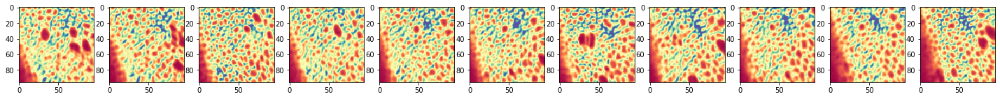

Epoch 88/250
8455/8455 [==============================] - 961s 114ms/step - loss: 1.3612 - accuracy: 0.9700 - val_loss: 1.4444 - val_accuracy: 0.9372

Epoch 00088: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


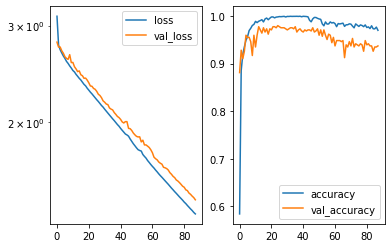

Predicted cell: Normal Probability: [[0.9999465]]
True Cell type: Normal
x [[0.49986568]]
True positional value x 0.5
y [[0.4978439]]
True positional value y 0.5
t [[0.4957552]]
True positional value t 0.5
h [[0.37053248]]
True positional value h 0.10416666666666667
w [[0.4003192]]
True positional value w 0.10416666666666667
c [[0.9242952]]
True positional value c 0.0


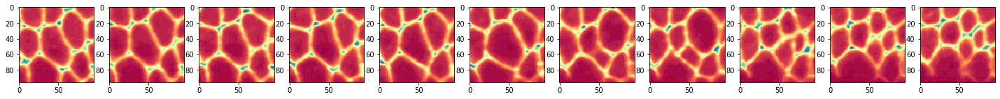

Epoch 89/250
8455/8455 [==============================] - 972s 115ms/step - loss: 1.3505 - accuracy: 0.9715 - val_loss: 1.4384 - val_accuracy: 0.9238

Epoch 00089: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


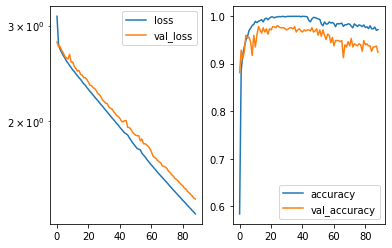

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.4978672]]
True positional value x 0.5
y [[0.50004464]]
True positional value y 0.5
t [[0.4965936]]
True positional value t 0.5
h [[0.521544]]
True positional value h 0.5625
w [[0.5385394]]
True positional value w 0.625
c [[0.9989926]]
True positional value c 1.0


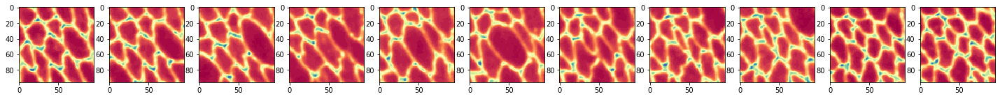

Epoch 90/250
8455/8455 [==============================] - 979s 116ms/step - loss: 1.3417 - accuracy: 0.9732 - val_loss: 1.4194 - val_accuracy: 0.9395

Epoch 00090: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


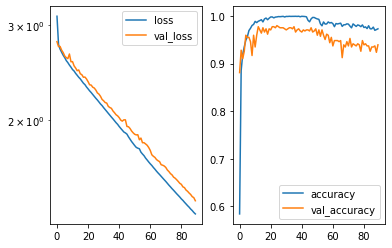

Predicted cell: Apoptosis Probability: [[0.9985159]]
True Cell type: Apoptosis
x [[0.50088805]]
True positional value x 0.5
y [[0.4994388]]
True positional value y 0.5
t [[0.49911514]]
True positional value t 0.5
h [[0.08515007]]
True positional value h 0.041666666666666664
w [[0.10251476]]
True positional value w 0.041666666666666664
c [[0.99737513]]
True positional value c 1.0


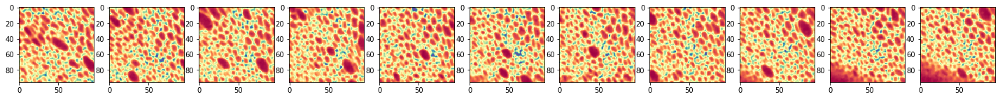

Epoch 91/250
8455/8455 [==============================] - 967s 114ms/step - loss: 1.3455 - accuracy: 0.9603 - val_loss: 1.4508 - val_accuracy: 0.9372

Epoch 00091: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


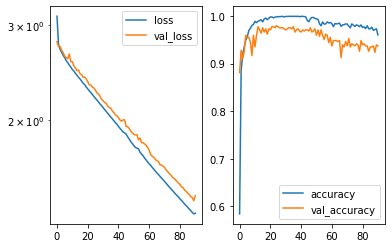

Predicted cell: Apoptosis Probability: [[0.99907243]]
True Cell type: Apoptosis
x [[0.495138]]
True positional value x 0.5
y [[0.50175154]]
True positional value y 0.5
t [[0.49993014]]
True positional value t 0.5
h [[0.14250116]]
True positional value h 0.10416666666666667
w [[0.21569951]]
True positional value w 0.19791666666666666
c [[0.83893824]]
True positional value c 1.0


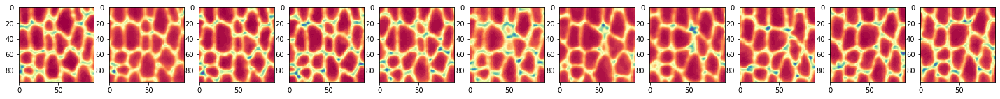

Epoch 92/250
8455/8455 [==============================] - 983s 116ms/step - loss: 1.3455 - accuracy: 0.9413 - val_loss: 1.4498 - val_accuracy: 0.8789

Epoch 00092: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


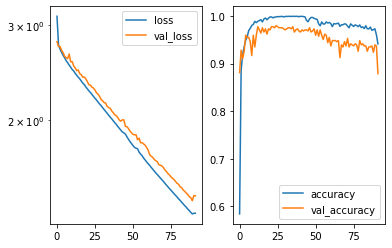

Predicted cell: Apoptosis Probability: [[0.99993396]]
True Cell type: Apoptosis
x [[0.4890083]]
True positional value x 0.5
y [[0.49972233]]
True positional value y 0.5
t [[0.50129825]]
True positional value t 0.5
h [[0.04378846]]
True positional value h 0.052083333333333336
w [[0.04502763]]
True positional value w 0.052083333333333336
c [[0.9942719]]
True positional value c 1.0


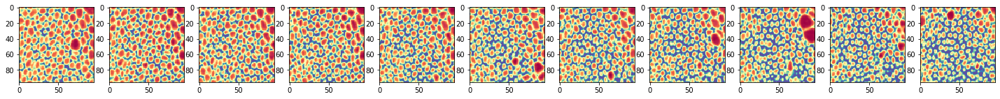

Epoch 93/250
8455/8455 [==============================] - 989s 117ms/step - loss: 1.3340 - accuracy: 0.9397 - val_loss: 1.3946 - val_accuracy: 0.8610

Epoch 00093: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


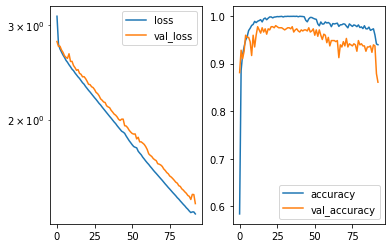

Predicted cell: Apoptosis Probability: [[0.9999975]]
True Cell type: Apoptosis
x [[0.50238746]]
True positional value x 0.5
y [[0.500775]]
True positional value y 0.5
t [[0.49816343]]
True positional value t 0.5
h [[0.04933722]]
True positional value h 0.03125
w [[0.06349826]]
True positional value w 0.041666666666666664
c [[0.9988206]]
True positional value c 1.0


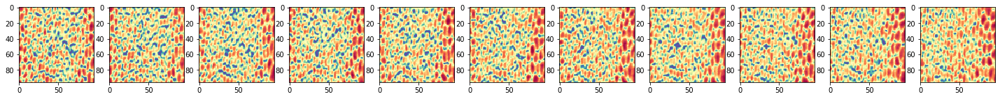

Epoch 94/250
8455/8455 [==============================] - 989s 117ms/step - loss: 1.3186 - accuracy: 0.9539 - val_loss: 1.3999 - val_accuracy: 0.9238

Epoch 00094: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


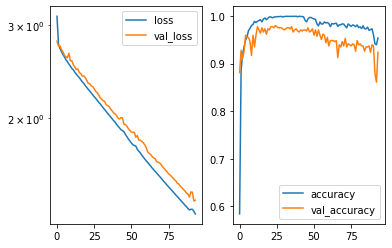

Predicted cell: Apoptosis Probability: [[0.9999083]]
True Cell type: Apoptosis
x [[0.5032264]]
True positional value x 0.5
y [[0.5068987]]
True positional value y 0.5
t [[0.5042525]]
True positional value t 0.5
h [[0.16681562]]
True positional value h 0.19791666666666666
w [[0.12363808]]
True positional value w 0.11458333333333333
c [[0.98227996]]
True positional value c 1.0


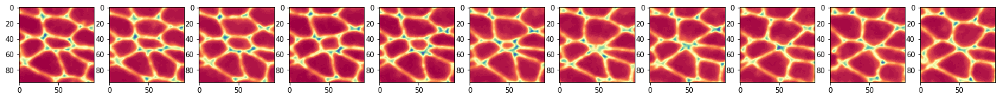

Epoch 95/250
8455/8455 [==============================] - 989s 117ms/step - loss: 1.3023 - accuracy: 0.9633 - val_loss: 1.4001 - val_accuracy: 0.9305

Epoch 00095: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


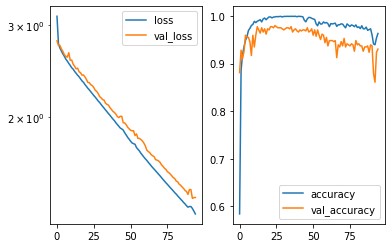

Predicted cell: Apoptosis Probability: [[0.9999541]]
True Cell type: Apoptosis
x [[0.4976609]]
True positional value x 0.5
y [[0.49675032]]
True positional value y 0.5
t [[0.49858886]]
True positional value t 0.5
h [[0.114531]]
True positional value h 0.08333333333333333
w [[0.19579466]]
True positional value w 0.11458333333333333
c [[0.9998789]]
True positional value c 1.0


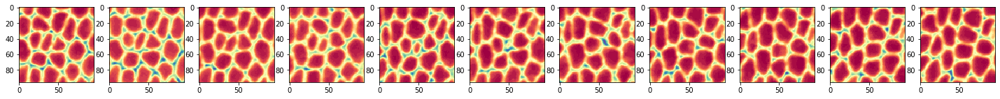

Epoch 96/250
8455/8455 [==============================] - 989s 117ms/step - loss: 1.2923 - accuracy: 0.9640 - val_loss: 1.3893 - val_accuracy: 0.9305

Epoch 00096: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


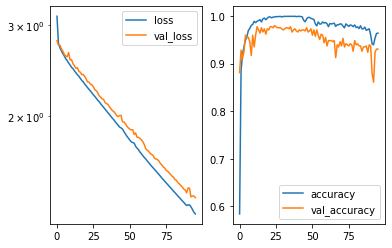

Predicted cell: Apoptosis Probability: [[1.]]
True Cell type: Apoptosis
x [[0.5028195]]
True positional value x 0.5
y [[0.50186974]]
True positional value y 0.5
t [[0.50039786]]
True positional value t 0.5
h [[0.04289267]]
True positional value h 0.052083333333333336
w [[0.05683212]]
True positional value w 0.052083333333333336
c [[0.9991021]]
True positional value c 1.0


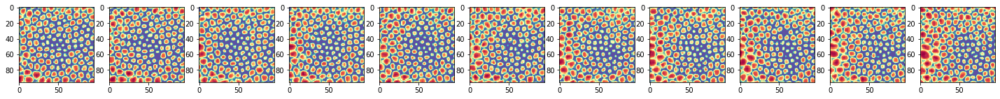

Epoch 97/250
8455/8455 [==============================] - 966s 114ms/step - loss: 1.2823 - accuracy: 0.9703 - val_loss: 1.3779 - val_accuracy: 0.9462

Epoch 00097: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


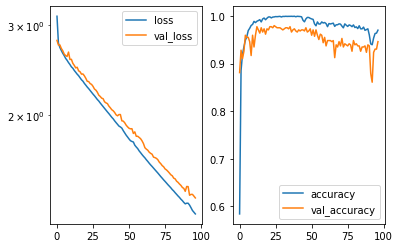

Predicted cell: Apoptosis Probability: [[0.99996126]]
True Cell type: Apoptosis
x [[0.5016778]]
True positional value x 0.5
y [[0.49703765]]
True positional value y 0.5
t [[0.49702376]]
True positional value t 0.5
h [[0.10214775]]
True positional value h 0.0625
w [[0.1041445]]
True positional value w 0.09375
c [[0.9779447]]
True positional value c 1.0


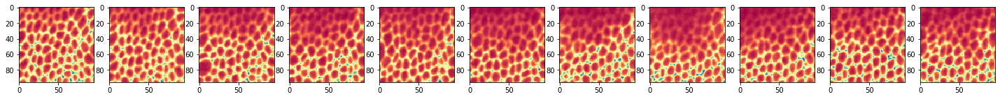

Epoch 98/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.2716 - accuracy: 0.9665 - val_loss: 1.3654 - val_accuracy: 0.9372

Epoch 00098: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


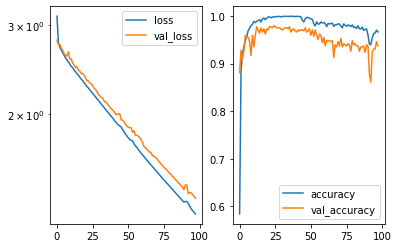

Predicted cell: Normal Probability: [[0.9999989]]
True Cell type: Normal
x [[0.499469]]
True positional value x 0.5
y [[0.50318295]]
True positional value y 0.5
t [[0.49267802]]
True positional value t 0.5
h [[0.28222856]]
True positional value h 0.34375
w [[0.33670348]]
True positional value w 0.3229166666666667
c [[0.9946149]]
True positional value c 1.0


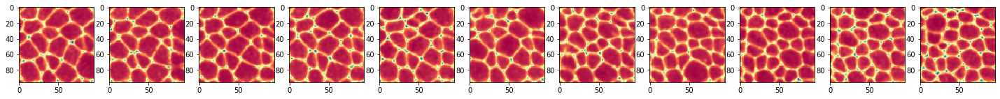

Epoch 99/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.2635 - accuracy: 0.9696 - val_loss: 1.3532 - val_accuracy: 0.9372

Epoch 00099: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


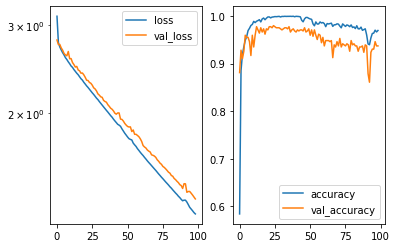

Predicted cell: Apoptosis Probability: [[0.9999989]]
True Cell type: Apoptosis
x [[0.49920377]]
True positional value x 0.5
y [[0.50070906]]
True positional value y 0.5
t [[0.5035609]]
True positional value t 0.5
h [[0.06922081]]
True positional value h 0.041666666666666664
w [[0.06605002]]
True positional value w 0.041666666666666664
c [[0.99965346]]
True positional value c 1.0


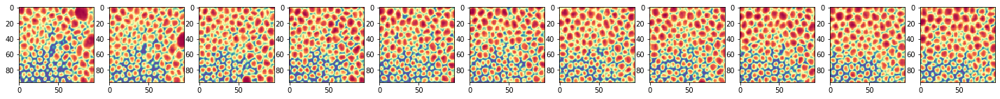

Epoch 100/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.2538 - accuracy: 0.9653 - val_loss: 1.3505 - val_accuracy: 0.9395

Epoch 00100: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


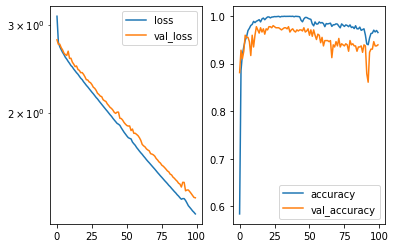

Predicted cell: Apoptosis Probability: [[1.]]
True Cell type: Apoptosis
x [[0.5053091]]
True positional value x 0.5
y [[0.50087243]]
True positional value y 0.5
t [[0.49931857]]
True positional value t 0.5
h [[0.04560528]]
True positional value h 0.041666666666666664
w [[0.05692876]]
True positional value w 0.041666666666666664
c [[0.99721056]]
True positional value c 1.0


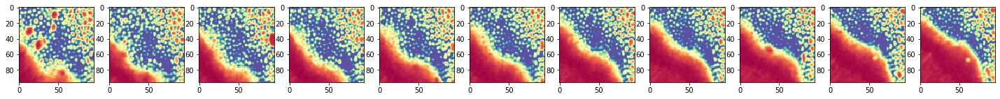

Epoch 101/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.2448 - accuracy: 0.9685 - val_loss: 1.3351 - val_accuracy: 0.9305

Epoch 00101: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


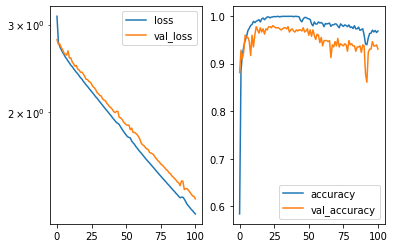

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.49973765]]
True positional value x 0.5
y [[0.50225574]]
True positional value y 0.5
t [[0.4996515]]
True positional value t 0.5
h [[0.58006275]]
True positional value h 0.6354166666666666
w [[0.44747788]]
True positional value w 0.5520833333333334
c [[0.9994916]]
True positional value c 1.0


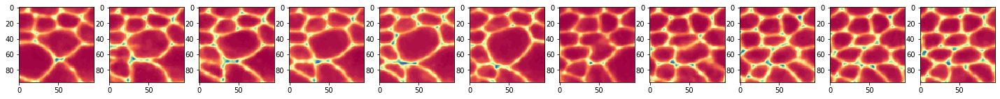

Epoch 102/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.2357 - accuracy: 0.9614 - val_loss: 1.3307 - val_accuracy: 0.9327

Epoch 00102: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


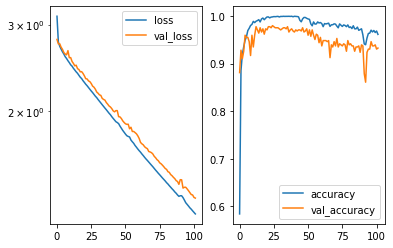

Predicted cell: Normal Probability: [[0.99990547]]
True Cell type: Normal
x [[0.4961718]]
True positional value x 0.5
y [[0.4970419]]
True positional value y 0.5
t [[0.4993463]]
True positional value t 0.5
h [[0.30404013]]
True positional value h 0.40625
w [[0.45210776]]
True positional value w 0.46875
c [[0.9969849]]
True positional value c 1.0


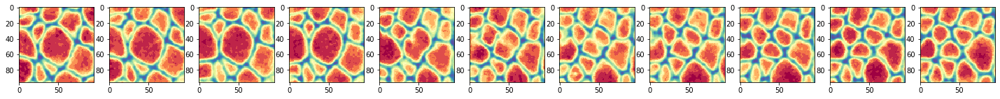

Epoch 103/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.2271 - accuracy: 0.9614 - val_loss: 1.3137 - val_accuracy: 0.9238

Epoch 00103: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


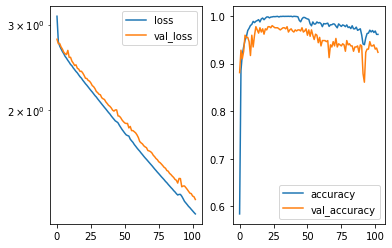

Predicted cell: Normal Probability: [[0.9999387]]
True Cell type: Normal
x [[0.4962137]]
True positional value x 0.5
y [[0.4997462]]
True positional value y 0.5
t [[0.50139266]]
True positional value t 0.5
h [[0.17483583]]
True positional value h 0.20833333333333334
w [[0.28567615]]
True positional value w 0.22916666666666666
c [[0.99996555]]
True positional value c 1.0


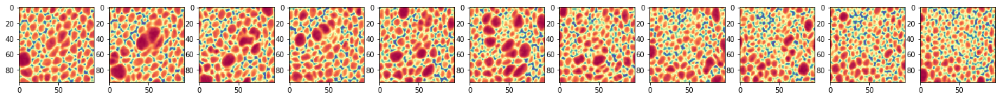

Epoch 104/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.2185 - accuracy: 0.9610 - val_loss: 1.3149 - val_accuracy: 0.9372

Epoch 00104: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


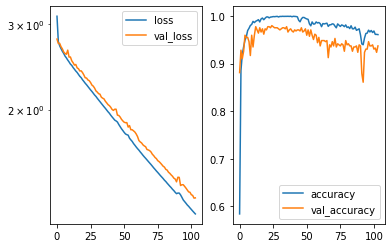

Predicted cell: Normal Probability: [[0.98522854]]
True Cell type: Normal
x [[0.4981412]]
True positional value x 0.5
y [[0.50347865]]
True positional value y 0.5
t [[0.49701127]]
True positional value t 0.5
h [[0.13353293]]
True positional value h 0.15625
w [[0.16821228]]
True positional value w 0.21875
c [[0.99936837]]
True positional value c 1.0


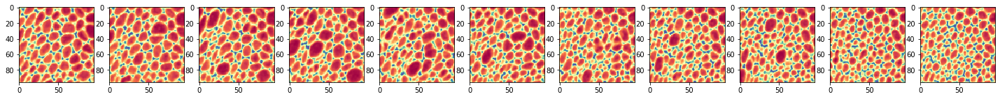

Epoch 105/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.2100 - accuracy: 0.9651 - val_loss: 1.3047 - val_accuracy: 0.9260

Epoch 00105: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


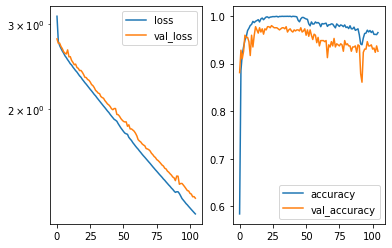

Predicted cell: Normal Probability: [[0.99999833]]
True Cell type: Normal
x [[0.4956416]]
True positional value x 0.5
y [[0.50152576]]
True positional value y 0.5
t [[0.4997972]]
True positional value t 0.5
h [[0.45356938]]
True positional value h 0.4166666666666667
w [[0.47686377]]
True positional value w 0.46875
c [[0.99895334]]
True positional value c 1.0


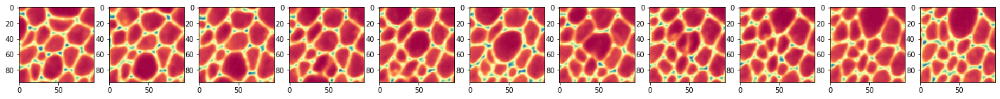

Epoch 106/250
8455/8455 [==============================] - 938s 111ms/step - loss: 1.2020 - accuracy: 0.9539 - val_loss: 1.2956 - val_accuracy: 0.9103

Epoch 00106: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


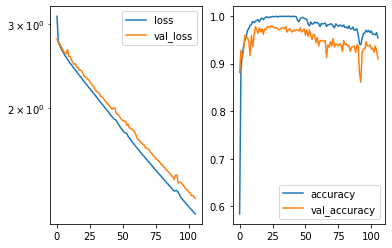

Predicted cell: Apoptosis Probability: [[0.9999933]]
True Cell type: Apoptosis
x [[0.499279]]
True positional value x 0.5
y [[0.5005707]]
True positional value y 0.5
t [[0.5006023]]
True positional value t 0.5
h [[0.06523184]]
True positional value h 0.07291666666666667
w [[0.07106792]]
True positional value w 0.07291666666666667
c [[0.9740331]]
True positional value c 1.0


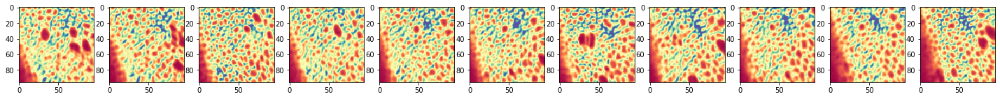

Epoch 107/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.1931 - accuracy: 0.9587 - val_loss: 1.2860 - val_accuracy: 0.9327

Epoch 00107: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


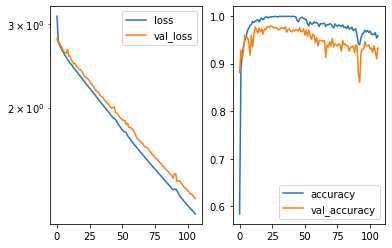

Predicted cell: Apoptosis Probability: [[0.9989299]]
True Cell type: Apoptosis
x [[0.49949232]]
True positional value x 0.5
y [[0.50007504]]
True positional value y 0.5
t [[0.5001381]]
True positional value t 0.5
h [[0.06008302]]
True positional value h 0.07291666666666667
w [[0.08957545]]
True positional value w 0.09375
c [[0.99780434]]
True positional value c 1.0


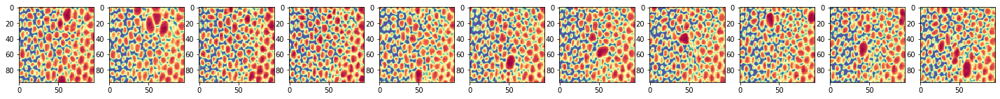

Epoch 108/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.1846 - accuracy: 0.9610 - val_loss: 1.2777 - val_accuracy: 0.9238

Epoch 00108: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


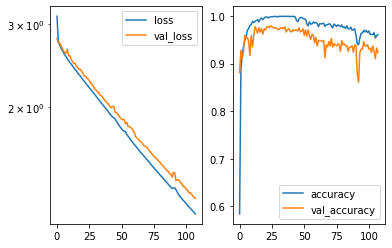

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.49720582]]
True positional value x 0.5
y [[0.5019332]]
True positional value y 0.5
t [[0.5013114]]
True positional value t 0.5
h [[0.5153618]]
True positional value h 0.5
w [[0.7232691]]
True positional value w 0.625
c [[0.9999378]]
True positional value c 1.0


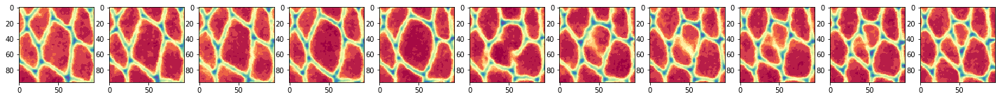

Epoch 109/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.1764 - accuracy: 0.9619 - val_loss: 1.2707 - val_accuracy: 0.9193

Epoch 00109: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


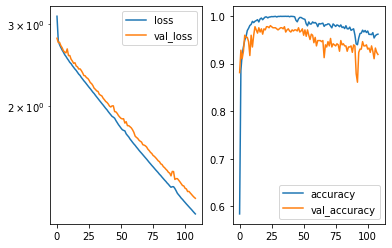

Predicted cell: Apoptosis Probability: [[0.999923]]
True Cell type: Apoptosis
x [[0.5029476]]
True positional value x 0.5
y [[0.4992166]]
True positional value y 0.5
t [[0.5003488]]
True positional value t 0.5
h [[0.08069849]]
True positional value h 0.07291666666666667
w [[0.11472617]]
True positional value w 0.07291666666666667
c [[0.9991456]]
True positional value c 1.0


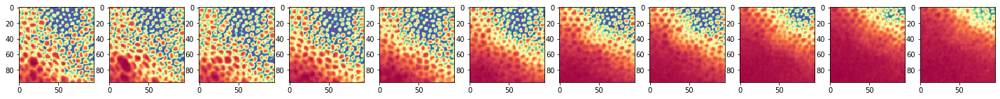

Epoch 110/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.1688 - accuracy: 0.9637 - val_loss: 1.2633 - val_accuracy: 0.9148

Epoch 00110: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


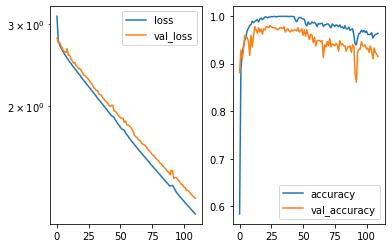

Predicted cell: Normal Probability: [[0.98057944]]
True Cell type: Normal
x [[0.49889997]]
True positional value x 0.5
y [[0.50005925]]
True positional value y 0.5
t [[0.49935204]]
True positional value t 0.5
h [[0.17168081]]
True positional value h 0.3541666666666667
w [[0.13730186]]
True positional value w 0.3125
c [[0.99977523]]
True positional value c 1.0


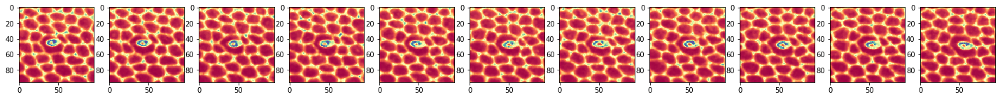

Epoch 111/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.1608 - accuracy: 0.9565 - val_loss: 1.2574 - val_accuracy: 0.9350

Epoch 00111: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


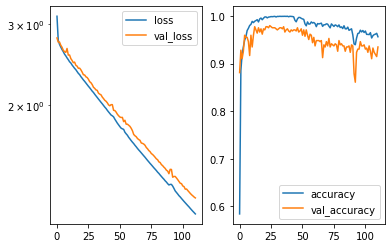

Predicted cell: Normal Probability: [[0.9999995]]
True Cell type: Normal
x [[0.50197506]]
True positional value x 0.5
y [[0.4977659]]
True positional value y 0.5
t [[0.49718612]]
True positional value t 0.5
h [[0.39681557]]
True positional value h 0.40625
w [[0.5087341]]
True positional value w 0.46875
c [[0.9994429]]
True positional value c 1.0


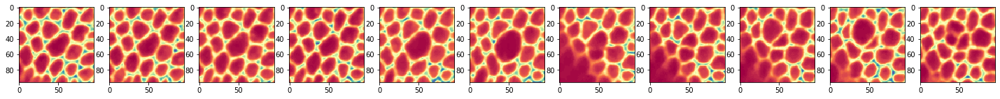

Epoch 112/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.1525 - accuracy: 0.9646 - val_loss: 1.2567 - val_accuracy: 0.9327

Epoch 00112: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


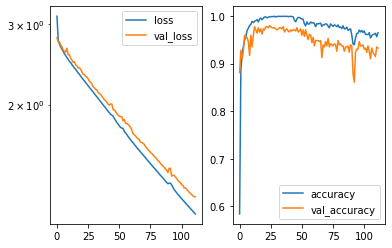

Predicted cell: Apoptosis Probability: [[0.9999907]]
True Cell type: Apoptosis
x [[0.5023327]]
True positional value x 0.5
y [[0.49839997]]
True positional value y 0.5
t [[0.49931085]]
True positional value t 0.5
h [[0.05908331]]
True positional value h 0.0625
w [[0.08794721]]
True positional value w 0.0625
c [[0.99995565]]
True positional value c 1.0


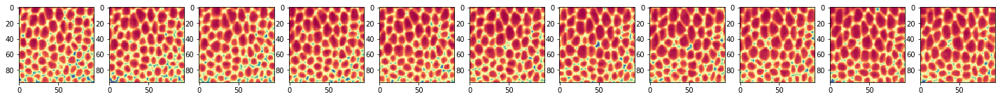

Epoch 113/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.1451 - accuracy: 0.9593 - val_loss: 1.2430 - val_accuracy: 0.9126

Epoch 00113: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


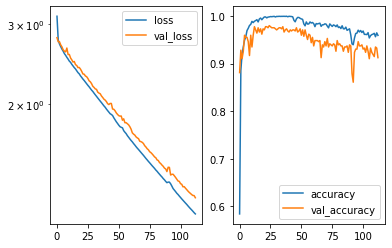

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.49975014]]
True positional value x 0.5
y [[0.49983758]]
True positional value y 0.5
t [[0.50101006]]
True positional value t 0.5
h [[0.55082524]]
True positional value h 0.5
w [[0.7106891]]
True positional value w 0.6666666666666666
c [[0.9998754]]
True positional value c 1.0


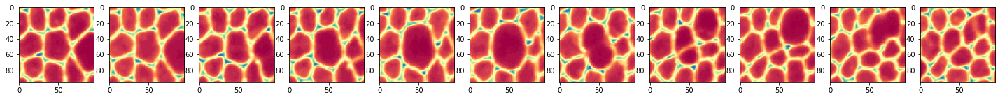

Epoch 114/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.1369 - accuracy: 0.9593 - val_loss: 1.2372 - val_accuracy: 0.9260

Epoch 00114: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


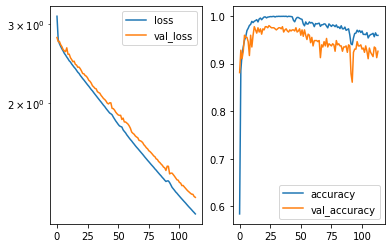

Predicted cell: Apoptosis Probability: [[0.99999833]]
True Cell type: Apoptosis
x [[0.4984806]]
True positional value x 0.5
y [[0.50180405]]
True positional value y 0.5
t [[0.49914327]]
True positional value t 0.5
h [[0.08520086]]
True positional value h 0.09375
w [[0.12713477]]
True positional value w 0.11458333333333333
c [[0.99832255]]
True positional value c 1.0


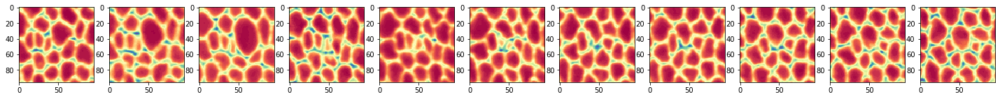

Epoch 115/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.1303 - accuracy: 0.9568 - val_loss: 1.2270 - val_accuracy: 0.9103

Epoch 00115: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


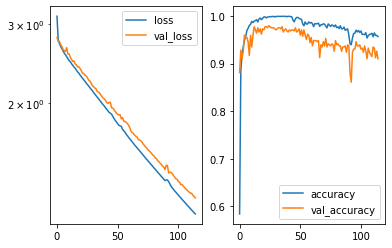

Predicted cell: Apoptosis Probability: [[0.9999571]]
True Cell type: Apoptosis
x [[0.4981768]]
True positional value x 0.5
y [[0.49764803]]
True positional value y 0.5
t [[0.5025132]]
True positional value t 0.5
h [[0.05420117]]
True positional value h 0.052083333333333336
w [[0.07389544]]
True positional value w 0.052083333333333336
c [[0.9621979]]
True positional value c 1.0


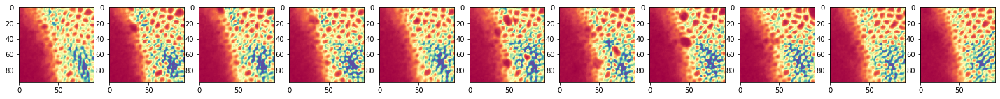

Epoch 116/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.1214 - accuracy: 0.9591 - val_loss: 1.2226 - val_accuracy: 0.9260

Epoch 00116: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


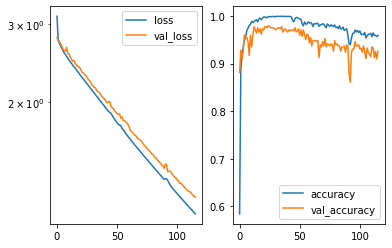

Predicted cell: Normal Probability: [[0.9999993]]
True Cell type: Normal
x [[0.50244385]]
True positional value x 0.5
y [[0.5071715]]
True positional value y 0.5
t [[0.50231254]]
True positional value t 0.5
h [[0.5514018]]
True positional value h 0.40625
w [[0.76352865]]
True positional value w 0.7291666666666666
c [[0.99997866]]
True positional value c 1.0


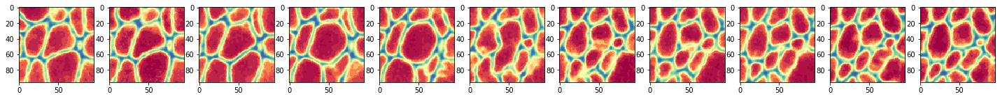

Epoch 117/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.1140 - accuracy: 0.9533 - val_loss: 1.2080 - val_accuracy: 0.9103

Epoch 00117: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


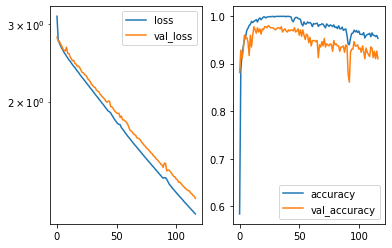

Predicted cell: Apoptosis Probability: [[0.99999964]]
True Cell type: Apoptosis
x [[0.49679887]]
True positional value x 0.5
y [[0.4974509]]
True positional value y 0.5
t [[0.5089708]]
True positional value t 0.5
h [[0.05834843]]
True positional value h 0.07291666666666667
w [[0.06382211]]
True positional value w 0.0625
c [[0.9722794]]
True positional value c 1.0


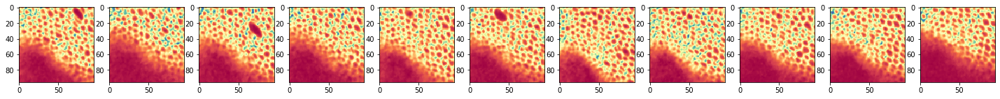

Epoch 118/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.1063 - accuracy: 0.9629 - val_loss: 1.2053 - val_accuracy: 0.9215

Epoch 00118: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


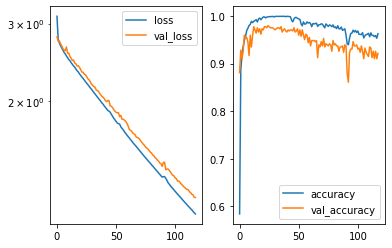

Predicted cell: Apoptosis Probability: [[0.9999993]]
True Cell type: Apoptosis
x [[0.49867696]]
True positional value x 0.5
y [[0.4997043]]
True positional value y 0.5
t [[0.49666587]]
True positional value t 0.5
h [[0.05454999]]
True positional value h 0.08333333333333333
w [[0.05427266]]
True positional value w 0.08333333333333333
c [[0.9990381]]
True positional value c 1.0


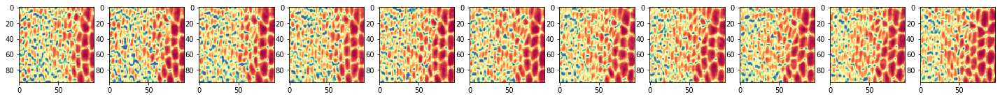

Epoch 119/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.0991 - accuracy: 0.9569 - val_loss: 1.1928 - val_accuracy: 0.9350

Epoch 00119: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


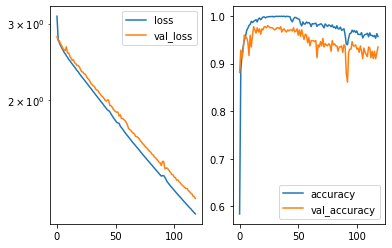

Predicted cell: Apoptosis Probability: [[0.99999213]]
True Cell type: Apoptosis
x [[0.4999206]]
True positional value x 0.5
y [[0.49952576]]
True positional value y 0.5
t [[0.50184876]]
True positional value t 0.5
h [[0.07475575]]
True positional value h 0.0625
w [[0.06579266]]
True positional value w 0.08333333333333333
c [[0.99949634]]
True positional value c 1.0


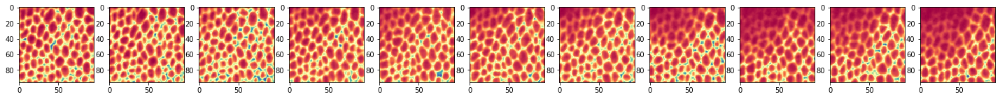

Epoch 120/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.0915 - accuracy: 0.9578 - val_loss: 1.1969 - val_accuracy: 0.9283

Epoch 00120: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


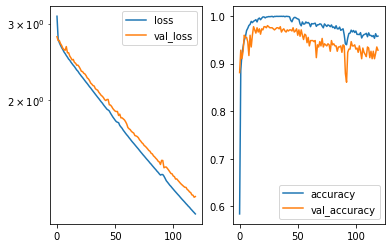

Predicted cell: Apoptosis Probability: [[0.9999974]]
True Cell type: Apoptosis
x [[0.50214213]]
True positional value x 0.5
y [[0.5005871]]
True positional value y 0.5
t [[0.4993052]]
True positional value t 0.5
h [[0.08683516]]
True positional value h 0.052083333333333336
w [[0.10872494]]
True positional value w 0.08333333333333333
c [[0.9940906]]
True positional value c 1.0


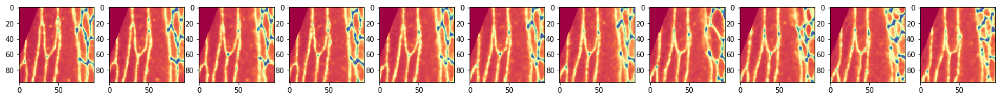

Epoch 121/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.0839 - accuracy: 0.9618 - val_loss: 1.1840 - val_accuracy: 0.9215

Epoch 00121: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


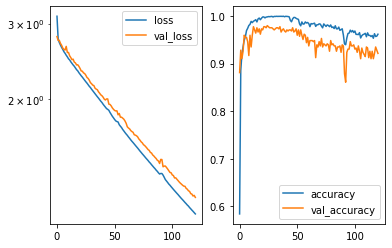

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.5020962]]
True positional value x 0.5
y [[0.50171876]]
True positional value y 0.5
t [[0.50071234]]
True positional value t 0.5
h [[0.3132349]]
True positional value h 0.34375
w [[0.5897073]]
True positional value w 0.5729166666666666
c [[0.9994229]]
True positional value c 1.0


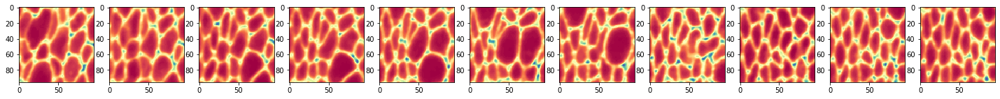

Epoch 122/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.0776 - accuracy: 0.9569 - val_loss: 1.1729 - val_accuracy: 0.9126

Epoch 00122: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


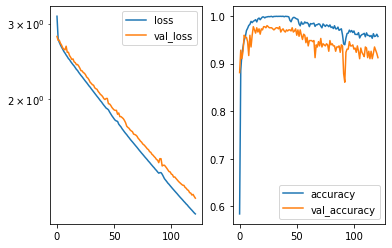

Predicted cell: Apoptosis Probability: [[0.99999964]]
True Cell type: Apoptosis
x [[0.49860746]]
True positional value x 0.5
y [[0.49998176]]
True positional value y 0.5
t [[0.4975727]]
True positional value t 0.5
h [[0.06411038]]
True positional value h 0.052083333333333336
w [[0.08773226]]
True positional value w 0.08333333333333333
c [[0.99999535]]
True positional value c 1.0


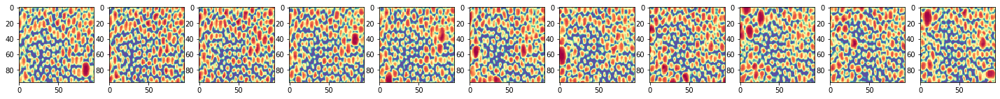

Epoch 123/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.0698 - accuracy: 0.9603 - val_loss: 1.1723 - val_accuracy: 0.9126

Epoch 00123: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


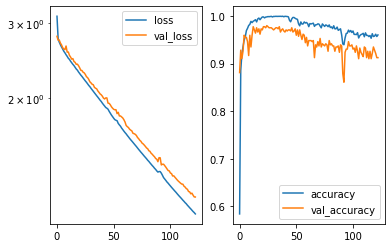

Predicted cell: Apoptosis Probability: [[1.]]
True Cell type: Apoptosis
x [[0.5013863]]
True positional value x 0.5
y [[0.49959406]]
True positional value y 0.5
t [[0.5012796]]
True positional value t 0.5
h [[0.04934495]]
True positional value h 0.052083333333333336
w [[0.05529663]]
True positional value w 0.041666666666666664
c [[0.9999927]]
True positional value c 1.0


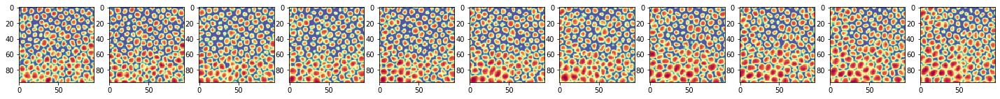

Epoch 124/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.0626 - accuracy: 0.9456 - val_loss: 1.1638 - val_accuracy: 0.8991

Epoch 00124: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


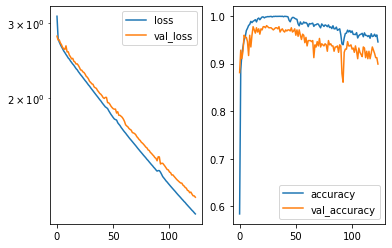

Predicted cell: Apoptosis Probability: [[0.99999404]]
True Cell type: Apoptosis
x [[0.4981827]]
True positional value x 0.5
y [[0.5001234]]
True positional value y 0.5
t [[0.49912593]]
True positional value t 0.5
h [[0.06427661]]
True positional value h 0.052083333333333336
w [[0.0584831]]
True positional value w 0.08333333333333333
c [[0.9593957]]
True positional value c 1.0


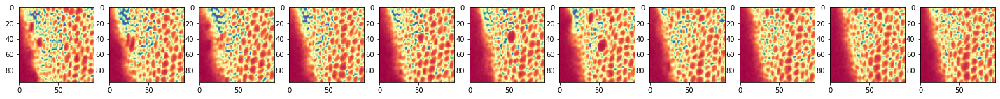

Epoch 125/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.0556 - accuracy: 0.9579 - val_loss: 1.1500 - val_accuracy: 0.9081

Epoch 00125: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


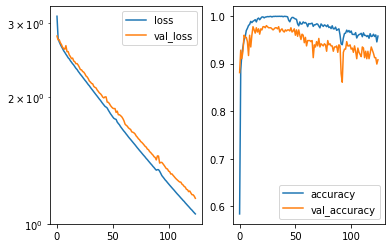

Predicted cell: Apoptosis Probability: [[0.99997485]]
True Cell type: Apoptosis
x [[0.5011648]]
True positional value x 0.5
y [[0.49811882]]
True positional value y 0.5
t [[0.50153255]]
True positional value t 0.5
h [[0.04686059]]
True positional value h 0.0625
w [[0.06267635]]
True positional value w 0.052083333333333336
c [[0.9904981]]
True positional value c 1.0


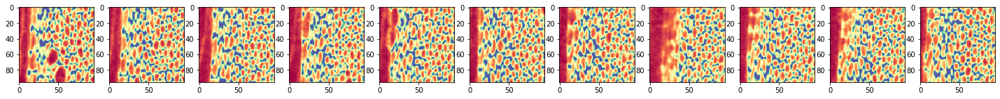

Epoch 126/250
8455/8455 [==============================] - 936s 111ms/step - loss: 1.0484 - accuracy: 0.9707 - val_loss: 1.1487 - val_accuracy: 0.9193

Epoch 00126: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


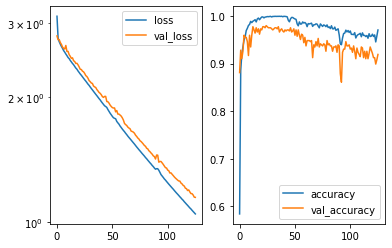

Predicted cell: Apoptosis Probability: [[0.9999999]]
True Cell type: Apoptosis
x [[0.49846384]]
True positional value x 0.5
y [[0.49639142]]
True positional value y 0.5
t [[0.5005932]]
True positional value t 0.5
h [[0.1057237]]
True positional value h 0.10416666666666667
w [[0.10522151]]
True positional value w 0.09375
c [[0.99855953]]
True positional value c 1.0


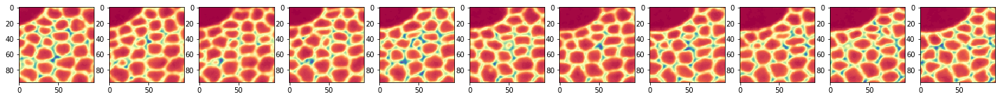

Epoch 127/250
8455/8455 [==============================] - 937s 111ms/step - loss: 1.0410 - accuracy: 0.9648 - val_loss: 1.1432 - val_accuracy: 0.9215

Epoch 00127: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


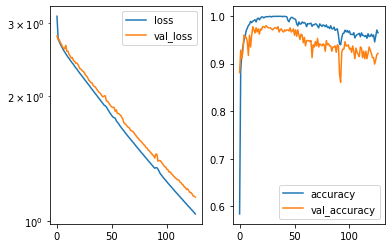

Predicted cell: Apoptosis Probability: [[0.9999987]]
True Cell type: Apoptosis
x [[0.50215507]]
True positional value x 0.5
y [[0.49679276]]
True positional value y 0.5
t [[0.49975914]]
True positional value t 0.5
h [[0.03989616]]
True positional value h 0.052083333333333336
w [[0.04269314]]
True positional value w 0.03125
c [[0.9992848]]
True positional value c 1.0


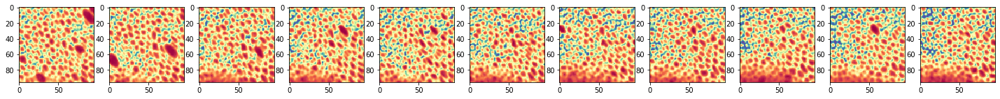

Epoch 128/250
8455/8455 [==============================] - 943s 112ms/step - loss: 1.0346 - accuracy: 0.9638 - val_loss: 1.1384 - val_accuracy: 0.9283

Epoch 00128: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


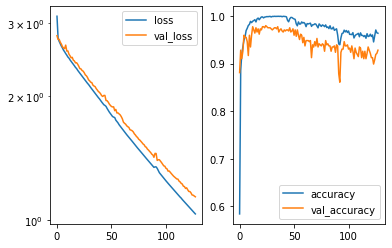

Predicted cell: Normal Probability: [[0.9584738]]
True Cell type: Normal
x [[0.49813432]]
True positional value x 0.5
y [[0.5026594]]
True positional value y 0.5
t [[0.4977795]]
True positional value t 0.5
h [[0.13836052]]
True positional value h 0.15625
w [[0.1582897]]
True positional value w 0.21875
c [[0.99950886]]
True positional value c 1.0


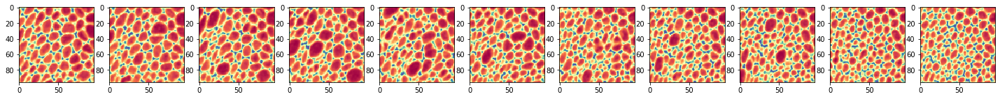

Epoch 129/250
8455/8455 [==============================] - 942s 111ms/step - loss: 1.0277 - accuracy: 0.9609 - val_loss: 1.1218 - val_accuracy: 0.9103

Epoch 00129: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


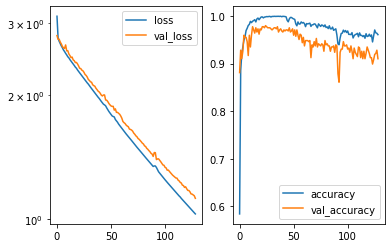

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.49895293]]
True positional value x 0.5
y [[0.49791008]]
True positional value y 0.5
t [[0.50197995]]
True positional value t 0.5
h [[0.5270828]]
True positional value h 0.5520833333333334
w [[0.6024517]]
True positional value w 0.59375
c [[0.99964607]]
True positional value c 1.0


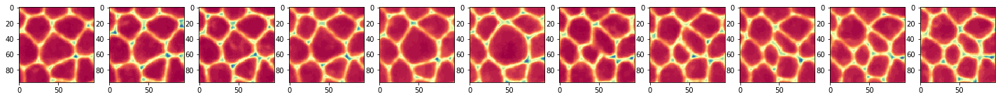

Epoch 130/250
8455/8455 [==============================] - 944s 112ms/step - loss: 1.0213 - accuracy: 0.9533 - val_loss: 1.1105 - val_accuracy: 0.9148

Epoch 00130: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


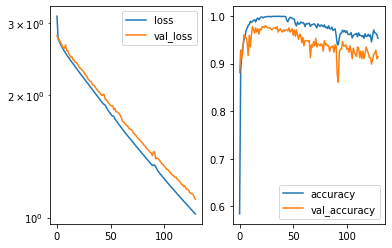

Predicted cell: Normal Probability: [[1.]]
True Cell type: Normal
x [[0.50169474]]
True positional value x 0.5
y [[0.5020515]]
True positional value y 0.5
t [[0.49987558]]
True positional value t 0.5
h [[0.399579]]
True positional value h 0.3854166666666667
w [[0.69092596]]
True positional value w 0.6666666666666666
c [[0.9995402]]
True positional value c 1.0


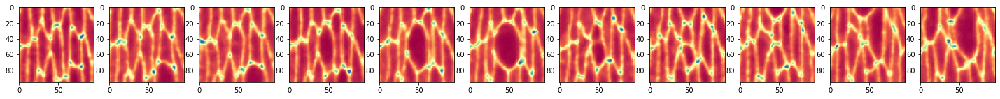

Epoch 131/250
8455/8455 [==============================] - 942s 111ms/step - loss: 1.0141 - accuracy: 0.9553 - val_loss: 1.1093 - val_accuracy: 0.9238

Epoch 00131: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


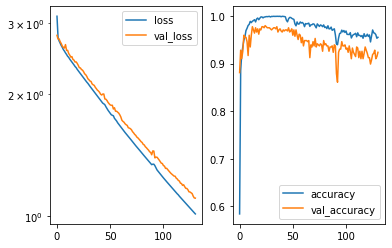

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.49883923]]
True positional value x 0.5
y [[0.499833]]
True positional value y 0.5
t [[0.4998547]]
True positional value t 0.5
h [[0.66742617]]
True positional value h 0.6770833333333334
w [[0.5813103]]
True positional value w 0.5520833333333334
c [[0.99990034]]
True positional value c 1.0


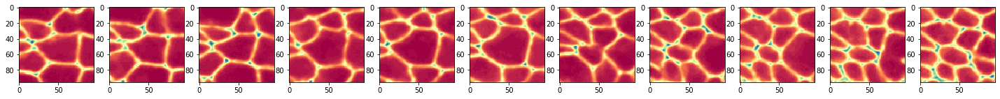

Epoch 132/250
8455/8455 [==============================] - 959s 113ms/step - loss: 1.0074 - accuracy: 0.9575 - val_loss: 1.1051 - val_accuracy: 0.9238

Epoch 00132: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


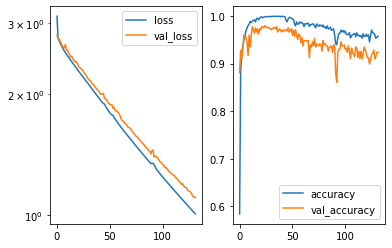

Predicted cell: Apoptosis Probability: [[0.9999733]]
True Cell type: Apoptosis
x [[0.5015655]]
True positional value x 0.5
y [[0.50003594]]
True positional value y 0.5
t [[0.496191]]
True positional value t 0.5
h [[0.09626332]]
True positional value h 0.07291666666666667
w [[0.06262818]]
True positional value w 0.041666666666666664
c [[0.9993131]]
True positional value c 1.0


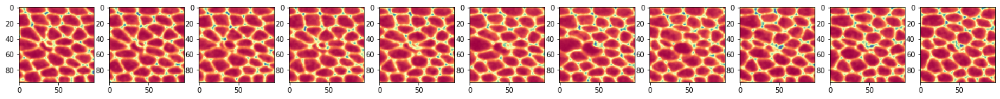

Epoch 133/250
8455/8455 [==============================] - 986s 117ms/step - loss: 1.0007 - accuracy: 0.9631 - val_loss: 1.0926 - val_accuracy: 0.9081

Epoch 00133: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


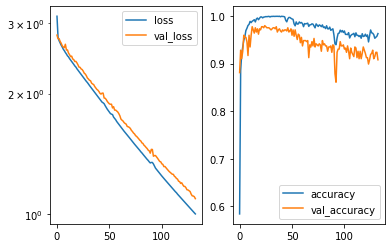

Predicted cell: Normal Probability: [[0.99999857]]
True Cell type: Normal
x [[0.4972544]]
True positional value x 0.5
y [[0.4981806]]
True positional value y 0.5
t [[0.49978015]]
True positional value t 0.5
h [[0.4318417]]
True positional value h 0.3958333333333333
w [[0.53912765]]
True positional value w 0.5520833333333334
c [[0.9999827]]
True positional value c 1.0


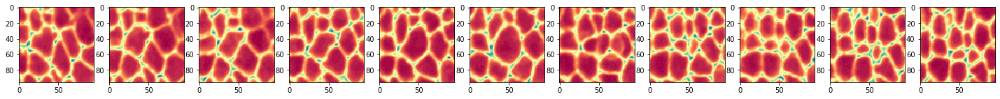

Epoch 134/250
8455/8455 [==============================] - 982s 116ms/step - loss: 0.9939 - accuracy: 0.9566 - val_loss: 1.0928 - val_accuracy: 0.9193

Epoch 00134: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


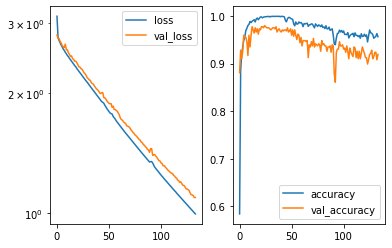

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.49941203]]
True positional value x 0.5
y [[0.49944183]]
True positional value y 0.5
t [[0.5005542]]
True positional value t 0.5
h [[0.29010287]]
True positional value h 0.3229166666666667
w [[0.24139887]]
True positional value w 0.2604166666666667
c [[0.9998597]]
True positional value c 1.0


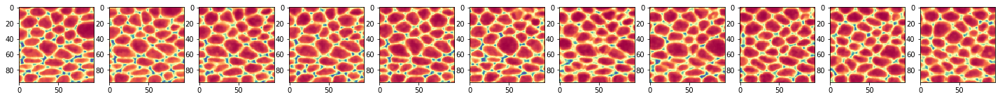

Epoch 135/250
8455/8455 [==============================] - 987s 117ms/step - loss: 0.9875 - accuracy: 0.9648 - val_loss: 1.0890 - val_accuracy: 0.9283

Epoch 00135: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


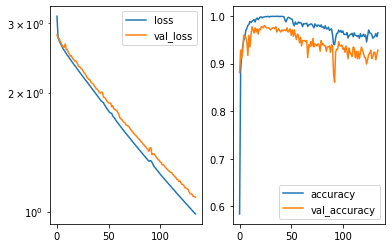

Predicted cell: Normal Probability: [[0.99999154]]
True Cell type: Normal
x [[0.5010261]]
True positional value x 0.5
y [[0.4970505]]
True positional value y 0.5
t [[0.50060236]]
True positional value t 0.5
h [[0.6820492]]
True positional value h 0.6666666666666666
w [[0.7314448]]
True positional value w 0.8333333333333334
c [[0.9992866]]
True positional value c 1.0


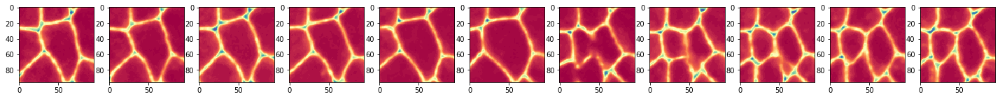

Epoch 136/250
8455/8455 [==============================] - 970s 115ms/step - loss: 0.9816 - accuracy: 0.9605 - val_loss: 1.0812 - val_accuracy: 0.9260

Epoch 00136: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


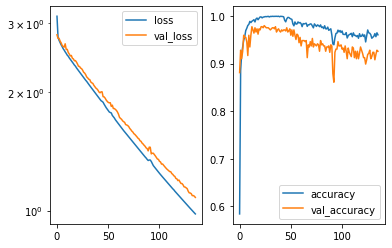

Predicted cell: Normal Probability: [[0.99999964]]
True Cell type: Normal
x [[0.5009619]]
True positional value x 0.5
y [[0.5000272]]
True positional value y 0.5
t [[0.5029535]]
True positional value t 0.5
h [[0.39535034]]
True positional value h 0.28125
w [[0.49106327]]
True positional value w 0.4479166666666667
c [[0.99997675]]
True positional value c 1.0


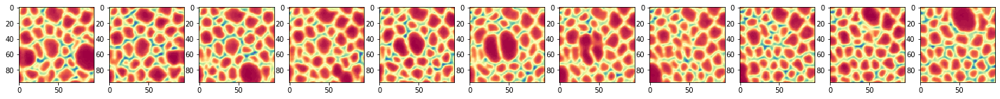

Epoch 137/250
8455/8455 [==============================] - 988s 117ms/step - loss: 0.9747 - accuracy: 0.9573 - val_loss: 1.0699 - val_accuracy: 0.9170

Epoch 00137: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


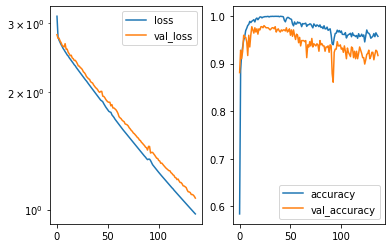

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.5010493]]
True positional value x 0.5
y [[0.50023556]]
True positional value y 0.5
t [[0.49841633]]
True positional value t 0.5
h [[0.26979572]]
True positional value h 0.2604166666666667
w [[0.48769677]]
True positional value w 0.46875
c [[0.99935156]]
True positional value c 1.0


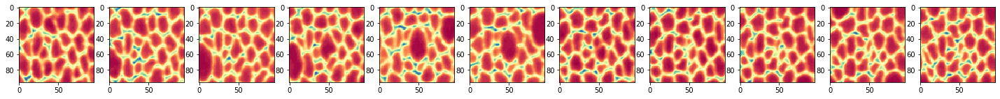

Epoch 138/250
8455/8455 [==============================] - 986s 117ms/step - loss: 0.9682 - accuracy: 0.9599 - val_loss: 1.0646 - val_accuracy: 0.9170

Epoch 00138: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


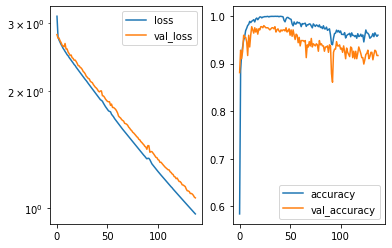

Predicted cell: Apoptosis Probability: [[0.99999905]]
True Cell type: Apoptosis
x [[0.5002923]]
True positional value x 0.5
y [[0.49975508]]
True positional value y 0.5
t [[0.5012446]]
True positional value t 0.5
h [[0.05830164]]
True positional value h 0.041666666666666664
w [[0.09383959]]
True positional value w 0.08333333333333333
c [[0.9994937]]
True positional value c 1.0


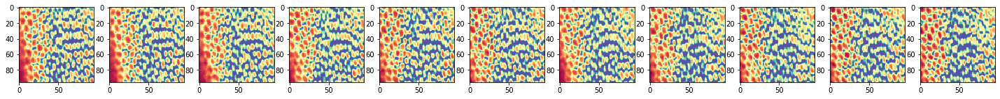

Epoch 139/250
8455/8455 [==============================] - 986s 117ms/step - loss: 0.9620 - accuracy: 0.9585 - val_loss: 1.0583 - val_accuracy: 0.9193

Epoch 00139: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


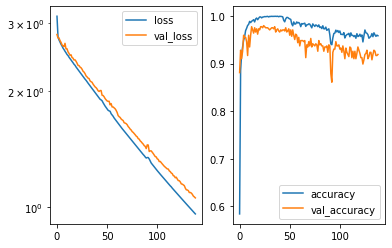

Predicted cell: Normal Probability: [[0.9999999]]
True Cell type: Normal
x [[0.49903032]]
True positional value x 0.5
y [[0.5006765]]
True positional value y 0.5
t [[0.5001652]]
True positional value t 0.5
h [[0.47004104]]
True positional value h 0.4791666666666667
w [[0.6942747]]
True positional value w 0.6875
c [[0.9998783]]
True positional value c 1.0


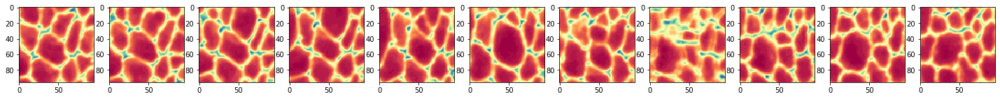

Epoch 140/250
8455/8455 [==============================] - 987s 117ms/step - loss: 0.9556 - accuracy: 0.9565 - val_loss: 1.0530 - val_accuracy: 0.9193

Epoch 00140: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


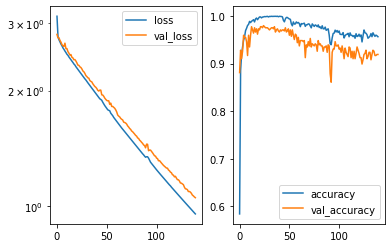

Predicted cell: Apoptosis Probability: [[0.99999714]]
True Cell type: Apoptosis
x [[0.5007078]]
True positional value x 0.5
y [[0.50137156]]
True positional value y 0.5
t [[0.5001589]]
True positional value t 0.5
h [[0.09396773]]
True positional value h 0.0625
w [[0.07409878]]
True positional value w 0.07291666666666667
c [[0.9985592]]
True positional value c 1.0


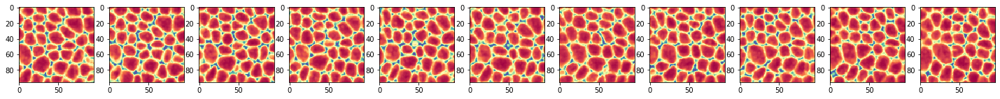

Epoch 141/250
8455/8455 [==============================] - 997s 118ms/step - loss: 0.9494 - accuracy: 0.9560 - val_loss: 1.0471 - val_accuracy: 0.9103

Epoch 00141: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


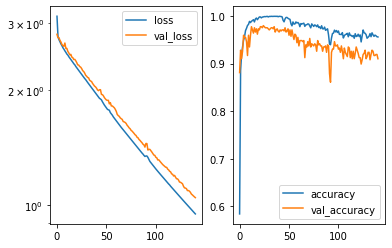

Predicted cell: Apoptosis Probability: [[0.9999958]]
True Cell type: Apoptosis
x [[0.49982858]]
True positional value x 0.5
y [[0.50173193]]
True positional value y 0.5
t [[0.5010055]]
True positional value t 0.5
h [[0.07631537]]
True positional value h 0.0625
w [[0.06663696]]
True positional value w 0.0625
c [[0.9998528]]
True positional value c 1.0


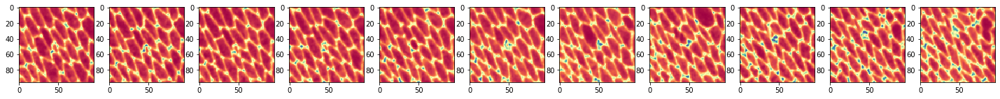

Epoch 142/250
8455/8455 [==============================] - 994s 118ms/step - loss: 0.9432 - accuracy: 0.9568 - val_loss: 1.0461 - val_accuracy: 0.9193

Epoch 00142: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


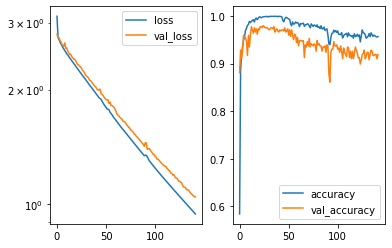

Predicted cell: Normal Probability: [[0.99999523]]
True Cell type: Normal
x [[0.49918333]]
True positional value x 0.5
y [[0.49872544]]
True positional value y 0.5
t [[0.49754795]]
True positional value t 0.5
h [[0.5692487]]
True positional value h 0.5625
w [[0.5197165]]
True positional value w 0.5729166666666666
c [[0.99887055]]
True positional value c 1.0


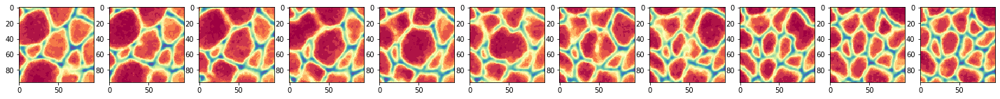

Epoch 143/250
8455/8455 [==============================] - 977s 116ms/step - loss: 0.9378 - accuracy: 0.9578 - val_loss: 1.0331 - val_accuracy: 0.9193

Epoch 00143: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


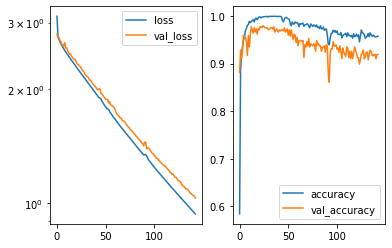

Predicted cell: Normal Probability: [[0.9999994]]
True Cell type: Normal
x [[0.49945843]]
True positional value x 0.5
y [[0.5003001]]
True positional value y 0.5
t [[0.50265354]]
True positional value t 0.5
h [[0.7319974]]
True positional value h 0.6979166666666666
w [[0.4976653]]
True positional value w 0.4895833333333333
c [[0.9991346]]
True positional value c 1.0


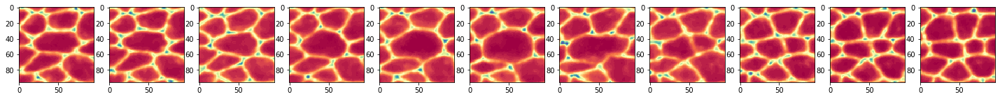

Epoch 144/250
8455/8455 [==============================] - 940s 111ms/step - loss: 0.9310 - accuracy: 0.9656 - val_loss: 1.0260 - val_accuracy: 0.9193

Epoch 00144: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


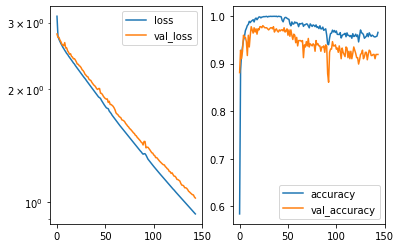

Predicted cell: Normal Probability: [[0.99999976]]
True Cell type: Normal
x [[0.49922943]]
True positional value x 0.5
y [[0.49964216]]
True positional value y 0.5
t [[0.49988195]]
True positional value t 0.5
h [[0.63387996]]
True positional value h 0.6354166666666666
w [[0.5089473]]
True positional value w 0.5208333333333334
c [[0.9844751]]
True positional value c 1.0


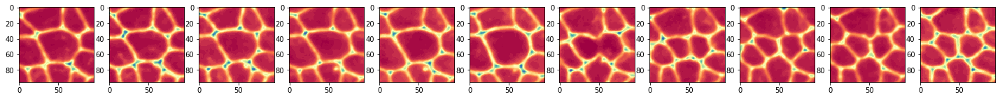

Epoch 145/250
8455/8455 [==============================] - 940s 111ms/step - loss: 0.9257 - accuracy: 0.9585 - val_loss: 1.0273 - val_accuracy: 0.9148

Epoch 00145: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


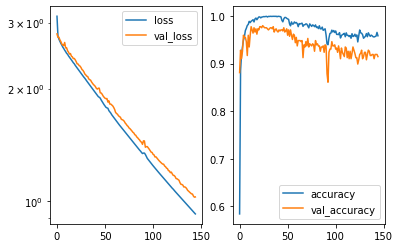

Predicted cell: Apoptosis Probability: [[0.9999999]]
True Cell type: Apoptosis
x [[0.49960193]]
True positional value x 0.5
y [[0.4991661]]
True positional value y 0.5
t [[0.5016502]]
True positional value t 0.5
h [[0.06098027]]
True positional value h 0.07291666666666667
w [[0.07501222]]
True positional value w 0.09375
c [[0.9990969]]
True positional value c 1.0


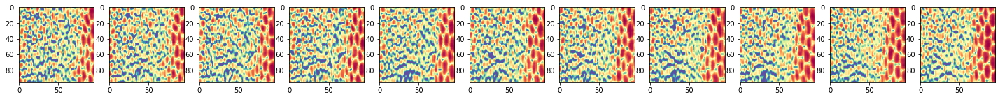

Epoch 146/250
8455/8455 [==============================] - 939s 111ms/step - loss: 0.9195 - accuracy: 0.9562 - val_loss: 1.0183 - val_accuracy: 0.9148

Epoch 00146: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


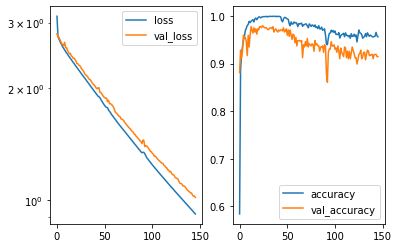

Predicted cell: Apoptosis Probability: [[0.9999305]]
True Cell type: Apoptosis
x [[0.49892598]]
True positional value x 0.5
y [[0.4987105]]
True positional value y 0.5
t [[0.49868476]]
True positional value t 0.5
h [[0.07381227]]
True positional value h 0.10416666666666667
w [[0.13957557]]
True positional value w 0.10416666666666667
c [[0.9912107]]
True positional value c 0.0


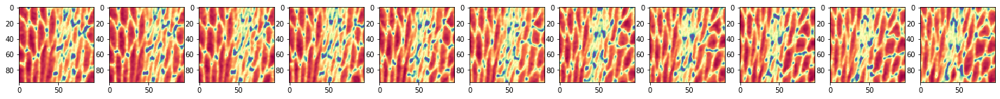

Epoch 147/250
8455/8455 [==============================] - 947s 112ms/step - loss: 0.9133 - accuracy: 0.9578 - val_loss: 1.0063 - val_accuracy: 0.9081

Epoch 00147: saving model to /home/sancere/Kepler/CurieDeepLearningModels/OneatModels/ApoptosisBinning1V1Models/wtapoptosisd29s4f16.h5


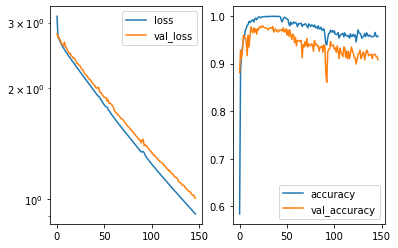

Predicted cell: Apoptosis Probability: [[0.9989625]]
True Cell type: Apoptosis
x [[0.5012583]]
True positional value x 0.5
y [[0.5014513]]
True positional value y 0.5
t [[0.49799368]]
True positional value t 0.5
h [[0.07145815]]
True positional value h 0.0625
w [[0.0886907]]
True positional value w 0.125
c [[0.99682754]]
True positional value c 1.0


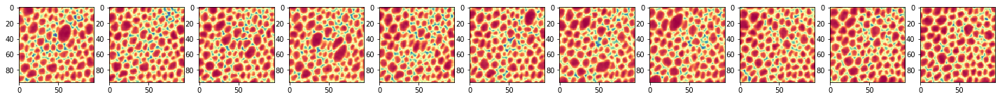

Epoch 148/250
1376/8455 [===>..........................] - ETA: 13:27 - loss: 0.9110 - accuracy: 0.9578

In [ ]:
Train = NEATDynamic(config, model_dir, model_name)

Train.loadData()

Train.TrainModel()